---

## Dataset Overview

In [54]:
# !pip install geopy

import pandas as pd  # for handling tabular data
import numpy as np  # for linear algebra

# for visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from scipy.stats import skew

from geopy.geocoders import Nominatim
from geopy.distance import geodesic

# for machine learning
from scipy.special import softmax
from sklearn.impute import KNNImputer

import warnings

# Ignore all warnings
warnings.filterwarnings('ignore')

from wordcloud import WordCloud
from geopy.distance import great_circle
from sklearn.cluster import KMeans
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer


In [55]:
df = pd.read_csv('Dataset\Homestays_Data(in).csv')
df.head()


,id,log_price,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,...,latitude,longitude,name,neighbourhood,number_of_reviews,review_scores_rating,thumbnail_url,zipcode,bedrooms,beds
0,6901257,5.010635,Apartment,Entire home/apt,"{""Wireless Internet"",""Air conditioning"",Kitche...",3,1.0,Real Bed,strict,True,...,40.696524,-73.991617,Beautiful brownstone 1-bedroom,Brooklyn Heights,2,100.0,https://a0.muscache.com/im/pictures/6d7cbbf7-c...,11201,1.0,1.0
1,6304928,5.129899,Apartment,Entire home/apt,"{""Wireless Internet"",""Air conditioning"",Kitche...",7,1.0,Real Bed,strict,True,...,40.766115,-73.989040,Superb 3BR Apt Located Near Times Square,Hell's Kitchen,6,93.0,https://a0.muscache.com/im/pictures/348a55fe-4...,10019,3.0,3.0
2,7919400,4.976734,Apartment,Entire home/apt,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",5,1.0,Real Bed,moderate,True,...,40.808110,-73.943756,The Garden Oasis,Harlem,10,92.0,https://a0.muscache.com/im/pictures/6fae5362-9...,10027,1.0,3.0
3,13418779,6.620073,House,Entire home/apt,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",4,1.0,Real Bed,flexible,True,...,37.772004,-122.431619,Beautiful Flat in the Heart of SF!,Lower Haight,0,NaN,https://a0.muscache.com/im/pictures/72208dad-9...,94117,2.0,2.0
4,3808709,4.744932,Apartment,Entire home/apt,"{TV,Internet,""Wireless Internet"",""Air conditio...",2,1.0,Real Bed,moderate,True,...,38.925627,-77.034596,Great studio in midtown DC,Columbia Heights,4,40.0,NaN,20009,0.0,1.0


In [56]:

# Select 5 random samples from the DataFrame
df_sample = df.sample(n=5, random_state=42)

# Print the sampled DataFrame
df_sample

# --------------------------------------
# Select 5 random samples from the DataFrame using the sample() method
# Set the random_state to 42 for reproducibility
# --------------------------------------


,id,log_price,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,...,latitude,longitude,name,neighbourhood,number_of_reviews,review_scores_rating,thumbnail_url,zipcode,bedrooms,beds
4079,13662370,3.806662,House,Private room,"{TV,Internet,""Wireless Internet"",""Air conditio...",2,1.5,Real Bed,strict,True,...,41.849684,-87.676270,Pilsen Arts Community Custom Home,Pilsen,17,97.0,https://a0.muscache.com/im/pictures/81318153/a...,60608,1.0,1.0
33735,4765892,4.941642,Apartment,Entire home/apt,"{TV,Internet,""Wireless Internet"",""Air conditio...",2,2.0,Real Bed,strict,True,...,34.068613,-118.246455,Apartment 5 minutes from DTLA & Dodger Stadium,Echo Park,2,100.0,https://a0.muscache.com/im/pictures/aa00250e-0...,90012,1.0,1.0
69475,21169968,4.941642,Apartment,Entire home/apt,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",5,1.0,Real Bed,moderate,True,...,40.701958,-73.917352,"Brand New Huge 2bdr apartment(L,M train 2 min)",Bushwick,25,88.0,https://a0.muscache.com/im/pictures/d9220535-c...,11237,2.0,3.0
454,7939196,4.867534,Apartment,Entire home/apt,"{""Cable TV"",Internet,""Wireless Internet"",""Air ...",6,1.0,Real Bed,strict,True,...,40.742959,-73.990820,Grande Super Large APT !!!,Flatiron District,12,82.0,NaN,10010,1.0,3.0
25153,18161036,3.663562,House,Private room,"{Internet,""Wireless Internet"",""Air conditionin...",2,1.0,Real Bed,flexible,True,...,34.046473,-117.734095,Private Cozy and Clean Rooms in Pomona,NaN,2,100.0,https://a0.muscache.com/im/pictures/e0c9b2f9-a...,91766,1.0,1.0


In [57]:
# Basic Overview about the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74111 entries, 0 to 74110
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      74111 non-null  int64  
 1   log_price               74111 non-null  float64
 2   property_type           74111 non-null  object 
 3   room_type               74111 non-null  object 
 4   amenities               74111 non-null  object 
 5   accommodates            74111 non-null  int64  
 6   bathrooms               73911 non-null  float64
 7   bed_type                74111 non-null  object 
 8   cancellation_policy     74111 non-null  object 
 9   cleaning_fee            74111 non-null  bool   
 10  city                    74111 non-null  object 
 11  description             74111 non-null  object 
 12  first_review            58247 non-null  object 
 13  host_has_profile_pic    73923 non-null  object 
 14  host_identity_verified  73923 non-null

In [58]:
# About data shape
print(f"Number of Rows/Instances: {df.shape[0]}")
print(f"Number of Columns: {df.shape[1]}")
print('-'*30)
print(f"Number of object columns: {len(df.select_dtypes(include='object').columns)}")
print(f"Number of Int/Float columns: {len(df.select_dtypes(exclude='object').columns)}")

# --------------------------------------
# - Number of Rows/Instances: This represents the total number of homestay listings in the dataset.
# - Number of Columns: This represents the total number of features or characteristics associated with each listing.
# - Number of object columns: These columns contain categorical or textual data.
# - Number of Int/Float columns: These columns contain numerical data.
# --------------------------------------


Number of Rows/Instances: 74111
Number of Columns: 29
------------------------------
Number of object columns: 18
Number of Int/Float columns: 11


In [59]:
# Define columns representing details about each column
info_cols = [
    'num_of_unique_values',  # Number of unique values in the column
    '%_of_null_values',       # Percentage of null values in the column
    'dtype_of_columns',       # Data type of the column
    'count',                  # Count of non-null values
    'unique',                 # Unique values in the column
    'top',                    # Most frequent value
    'freq',                   # Frequency of the most frequent value
    'mean',                   # Mean of numerical values
    'std',                    # Standard deviation of numerical values
    'min',                    # Minimum value
    '25%',                    # 25th percentile
    '50%',                    # 50th percentile (median)
    '75%',                    # 75th percentile
    'max'                     # Maximum value
]

# Get the names of the original columns
cols = df.columns

# Finding all the unique values in each column
unique_values = []

# Iterate through each column and get unique values
for col in df.columns:
    temp = list(df[col].unique())  # Get unique values for the column
    unique_values.append(temp)     # Append unique values to the list

In [60]:
# Calculate basic descriptive statistics for all columns
descriptive_stats = df.describe(include='all').fillna("not-applicable")

In [61]:
descriptive_stats

,id,log_price,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,...,latitude,longitude,name,neighbourhood,number_of_reviews,review_scores_rating,thumbnail_url,zipcode,bedrooms,beds
count,74111.0,74111.0,74111,74111,74111,74111.0,73911.0,74111,74111,74111,...,74111.0,74111.0,74111,67239,74111.0,57389.0,65895,73145,74020.0,73980.0
unique,not-applicable,not-applicable,35,3,67122,not-applicable,not-applicable,5,5,2,...,not-applicable,not-applicable,73350,619,not-applicable,not-applicable,65883,669,not-applicable,not-applicable
top,not-applicable,not-applicable,Apartment,Entire home/apt,{},not-applicable,not-applicable,Real Bed,strict,True,...,not-applicable,not-applicable,#NAME?,Williamsburg,not-applicable,not-applicable,https://a0.muscache.com/im/pictures/70087089/b...,11211,not-applicable,not-applicable
freq,not-applicable,not-applicable,49003,41310,586,not-applicable,not-applicable,72028,32374,54403,...,not-applicable,not-applicable,10,2862,not-applicable,not-applicable,3,1618,not-applicable,not-applicable
mean,11266617.102468,4.782069,not-applicable,not-applicable,not-applicable,3.155146,1.235263,not-applicable,not-applicable,not-applicable,...,38.445958,-92.397525,not-applicable,not-applicable,20.900568,94.067365,not-applicable,not-applicable,1.265793,1.710868
std,6081734.886894,0.717394,not-applicable,not-applicable,not-applicable,2.153589,0.582044,not-applicable,not-applicable,not-applicable,...,3.080167,21.705322,not-applicable,not-applicable,37.828641,7.836556,not-applicable,not-applicable,0.852143,1.254142
min,344.0,0.0,not-applicable,not-applicable,not-applicable,1.0,0.0,not-applicable,not-applicable,not-applicable,...,33.338905,-122.5115,not-applicable,not-applicable,0.0,20.0,not-applicable,not-applicable,0.0,0.0
25%,6261964.5,4.317488,not-applicable,not-applicable,not-applicable,2.0,1.0,not-applicable,not-applicable,not-applicable,...,34.127908,-118.342374,not-applicable,not-applicable,1.0,92.0,not-applicable,not-applicable,1.0,1.0
50%,12254147.0,4.70953,not-applicable,not-applicable,not-applicable,2.0,1.0,not-applicable,not-applicable,not-applicable,...,40.662138,-76.996965,not-applicable,not-applicable,6.0,96.0,not-applicable,not-applicable,1.0,1.0
75%,16402260.5,5.220356,not-applicable,not-applicable,not-applicable,4.0,1.0,not-applicable,not-applicable,not-applicable,...,40.746096,-73.95466,not-applicable,not-applicable,23.0,100.0,not-applicable,not-applicable,1.0,2.0


In [62]:
# Create a DataFrame to store insights about the data
column_Insight_df = pd.DataFrame(
    {
        info_cols[0]: df.nunique().to_list(),      # Number of unique values in each column
        info_cols[1]: df.isnull().mean(),          # Percentage of missing values in each column
        info_cols[2]: list(df.dtypes),             # Data types of each column
        info_cols[3]: list(df.count()),            # Non-null value count in each column
        info_cols[4]: unique_values                # Unique values in each column
    },
    index=cols  # Column names as index
)


In [63]:
column_Insight_df

,num_of_unique_values,%_of_null_values,dtype_of_columns,count,unique
id,74111,0.000000,int64,74111,"[6901257, 6304928, 7919400, 13418779, 3808709,..."
log_price,767,0.000000,float64,74111,"[5.010635294, 5.129898715, 4.976733742, 6.6200..."
property_type,35,0.000000,object,74111,"[Apartment, House, Condominium, Loft, Townhous..."
room_type,3,0.000000,object,74111,"[Entire home/apt, Private room, Shared room]"
amenities,67122,0.000000,object,74111,"[{""Wireless Internet"",""Air conditioning"",Kitch..."
accommodates,16,0.000000,int64,74111,"[3, 7, 5, 4, 2, 6, 8, 1, 9, 10, 16, 11, 12, 14..."
bathrooms,17,0.002699,float64,73911,"[1.0, 1.5, 2.0, nan, 2.5, 3.0, 0.5, 4.5, 5.0, ..."
bed_type,5,0.000000,object,74111,"[Real Bed, Futon, Pull-out Sofa, Couch, Airbed]"
cancellation_policy,5,0.000000,object,74111,"[strict, moderate, flexible, super_strict_30, ..."
cleaning_fee,2,0.000000,bool,74111,"[True, False]"


---

# Evidently monitiring

In [11]:
# !pip install evidently

In [12]:
# import pandas as pd
# from sklearn import datasets
# from evidently.ui.workspace.cloud import CloudWorkspace
# from evidently.report import Report
# from evidently.metric_preset import DataQualityPreset, DataDriftPreset, TargetDriftPreset, RegressionPreset


In [13]:
# # Load the data for model monitoring from the provided CSV file
# monitoring_data = df.copy()

# # Rename the target column to 'target' for clarity
# monitoring_data.rename(columns={'log_price': 'target'}, inplace=True)


In [14]:
# # Create a CloudWorkspace instance with the provided token and URL
# workspace = CloudWorkspace(token="dG9rbgHfd9TQMR1Mup4FnQPNmSJvhu/fCmZ54q/kmiB6eZLw3wBQcLmwfGJhMDKPeCb9nntFsnf7pnH4oS5SDsmyl7k2gYB0/YmnbXVOog4/gouWHzka9rov9yNMmYIdTvBNhdbOWjOF7xpq03LzE0dQ1RJ3O8fpxyoV",
#                            url="https://app.evidently.cloud")

# # Create a new project within the workspace for Home Stays Model Development
# project = workspace.create_project("Home Stays Model Dev")

# # Add a description to the project
# project.description = "Developing the model for production"

# # Save the changes to the project
# project.save()


In [15]:
# # Splitting the training data into reference data and current data
# reference_data = monitoring_data[:int(len(monitoring_data) * 0.8)]  # 80% of the training data for reference
# current_data = monitoring_data[int(len(monitoring_data) * 0.8):]     # Remaining 20% of the training data for current analysis


In [16]:
# # Create a data report object with data quality metrics
# data_report = Report(
#     metrics=[
#         DataQualityPreset(),
#     ]
# )

# # Run the data quality metrics on the reference and current data
# data_report.run(reference_data=reference_data, current_data=current_data)

# # Add the data report to the project in the workspace
# workspace.add_report(project_id=project.id, report=data_report)


In [17]:
# data_report

In [18]:
# data_drift_report = Report(
#        metrics=[
#            DataDriftPreset(),
#        ],
#     )
# data_drift_report.run(reference_data=reference_data, current_data=current_data)
# workspace.add_report(project.id, data_drift_report)

In [19]:
# data_drift_report

In [20]:
# num_target_drift_report = Report(metrics=[
#     TargetDriftPreset(),
# ])

# num_target_drift_report.run(reference_data=reference_data, current_data=current_data)
# workspace.add_report(project.id, num_target_drift_report)

In [21]:
# num_target_drift_report

In [22]:
# from evidently.metric_preset import RegressionPreset

# reg_performance_report = Report(metrics=[
#     RegressionPreset(),
# ])

# reg_performance_report.run(reference_data=reference_data, current_data=current_data)
# workspace.add_report(project.id, reg_performance_report)

In [23]:
# reg_performance_report

---

# Data Cleaning and Preparation:

### Real-world data often contains inconsistencies, missing values, errors, and formatting issues.

> #### Cleaning the data to ensure to its accuracy and usability:

            1.      Identifying and handle missing values (deletion, imputation).
            2.      Correcting the errors and inconsistencies.
            3.      Standardizeing data formats (dates, currencies, etc.).
            4.      Removeing the irrelevant or duplicate data points.

#### functions for checking outliers

In [76]:
# Method 1: Frequency Table and Visualization
def check_outliers_freq_table(data, col):
  # Create frequency table
  frequency_table = data[col].value_counts().reset_index(name='Frequency')
  frequency_table['Relative Frequency'] = frequency_table['Frequency'] / len(data)

  # Print frequency table
  print("Frequency Table:")
  print(frequency_table.to_string(index=True))

  # Visualize distribution (optional)
  frequency_table.plot(kind='bar', x=f'{col}', y='Frequency', title='Frequency Distribution')
  plt.show()

  # Identify potential outliers based on frequency (adjust threshold as needed)
  outlier_threshold = 0.1  # Adjust this based on your data and analysis goals
  outliers = frequency_table[frequency_table['Relative Frequency'] < outlier_threshold][col].tolist()
  print("\nPotential outliers based on frequency (less than", outlier_threshold, "relative frequency):")
  print(outliers)

# Method 2: IQR (for ordinal data)
def check_outliers_iqr(data):
  if not pd.api.types.is_categorical_dtype(data):
    print("IQR method is only applicable for ordinal data (categories with natural order).")
    return

  # Check if categories have an order (optional)
  categories = data.unique()
  if not all(categories[i] <= categories[i+1] for i in range(len(categories)-1)):
    print("Categories in your data do not seem to have a natural order. IQR method might not be suitable.")
    return

  # Calculate IQR
  Q1 = data.quantile(0.25)
  Q3 = data.quantile(0.75)
  IQR = Q3 - Q1

  # Define upper and lower bounds
  upper_bound = Q3 + (1.5 * IQR)
  lower_bound = Q1 - (1.5 * IQR)

  # Identify outliers using IQR rule
  outliers = data[(data > upper_bound) | (data < lower_bound)].tolist()
  print("\nPotential outliers based on IQR rule:")
  print(outliers)


#### functions for plotting

In [77]:
def plot_kde(data, column, shade=True, color="b", bw_method=0.5, xlabel=None, ylabel=None):
    """
    Create a KDE plot using Seaborn.

    Parameters:
    - data (DataFrame): The DataFrame containing the data to be plotted.
    - column (str): The column name for which KDE plot will be created.
    - shade (bool, optional): Whether to shade the area under the KDE curve. Default is True.
    - color (str, optional): The color of the KDE curve. Default is "b" (blue).
    - bw_method (float, optional): The bandwidth of the KDE. Default is 0.5.
    - xlabel (str, optional): Label for the x-axis. Default is None (uses column name).
    - ylabel (str, optional): Label for the y-axis. Default is None.

    Returns:
    - None
    """
    sns.set(style="whitegrid")  # Setting the style
    plt.figure(figsize=(10, 8))  # Setting figure size

    # Creating KDE plot
    sns.kdeplot(data[column], shade=shade, color=color, bw_method=bw_method)

    # Adding labels and title
    if not xlabel:
        xlabel = column  # Use column name as xlabel if not specified
    plt.xlabel(xlabel)
    if ylabel:
        plt.ylabel(ylabel)
    plt.title(f"{column} KDE Plot")  # Adding column name to the title

    # Display the plot
    plt.show()


def plot_kde_before_after_imputation(original_data, imputed_data, column, bw_method=0.5):
    """
    Create a KDE plot comparing the distribution before and after imputation.

    Parameters:
    - original_data (Series or DataFrame): The original data before imputation.
    - imputed_data (Series or DataFrame): The imputed data after imputation.
    - column (str): The column name for which KDE plot will be created.
    - bw_method (float, optional): The bandwidth of the KDE. Default is 0.5.

    Returns:
    - None
    """
    sns.set(style="whitegrid")  # Setting the style
    plt.figure(figsize=(10, 6))  # Setting figure size

    # Before imputation (original data)
    sns.kdeplot(original_data[column], label='Before Imputation', shade=True, color="b", bw_method=bw_method)

    # After imputation
    sns.kdeplot(imputed_data, label='After Imputation', linestyle='--', shade=True, color="g", bw_method=bw_method)

    # Customize the plot
    plt.title(f'Distribution of {column} (Before and After Imputation)')
    plt.xlabel(column)
    plt.ylabel('Density')
    plt.legend(title='Data')

    # Show the plot
    plt.show()


def create_seaborn_countplot(data, x, palette='viridis', title='Count Plot'):
    """
    Create a count plot using Seaborn with a specified color palette.

    Parameters:
    - data (DataFrame): The DataFrame containing the data to be plotted.
    - x (str): The column name of the categorical variable.
    - palette (str or list of colors, optional): The color palette to use. Default is 'viridis'.
    - title (str, optional): The title of the plot. Default is 'Count Plot'.

    Returns:
    - None
    """
    plt.figure(figsize=(33, 16))
    sns.countplot(x=x, data=data, palette=palette)
    plt.title(title)
    plt.show()


import plotly.express as px

def create_plotly_countplot(data, x, color='green', title='Count Plot'):
    """
    Create a count plot using Plotly Express with a specified color.

    Parameters:
    - data (DataFrame): The DataFrame containing the data to be plotted.
    - x (str): The column name of the categorical variable.
    - color (str, optional): The color to use. Default is 'green'.
    - title (str, optional): The title of the plot. Default is 'Count Plot'.

    Returns:
    - None
    """
    fig = px.histogram(data, x=x, color_discrete_sequence=[color],text_auto=True)
    fig.update_layout(title=title)
    fig.show()



def plot_barplot(df, xcol, ycol, title=None):
    """
    Create a barplot for a specified column in a DataFrame.

    Parameters:
        df (DataFrame): The input DataFrame.
        xcol (str): The name of the column to use for the x-axis.
        ycol (str): The name of the column to use for the y-axis.
        title (str, optional): The title of the plot. Defaults to None.

    Returns:
        matplotlib.axes._subplots.AxesSubplot: The created barplot.
    """
    # Set Seaborn style
    sns.set_style("whitegrid")

    # Create barplot
    plt.figure(figsize=(12, 8))  # Adjust size as needed
    ax = sns.barplot(x=df[xcol], y=df[ycol])

    # Add labels and title
    ax.set_xlabel(xcol)
    ax.set_ylabel('Count')
    ax.set_title(title if title else f'Barplot of {xcol}')

    # Rotate x-axis labels if needed
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

    # Show plot
    plt.show()

    return ax


def plot_correlation_heatmap(df, columns):
    """
    Plot a heatmap showing the correlation between specified columns in a DataFrame.

    Parameters:
        df (DataFrame): The input DataFrame.
        columns (list): A list of column names to include in the heatmap.

    Returns:
        None
    """
    # Set Seaborn style
    sns.set_style("whitegrid")

    # Calculate correlation matrix
    corr_matrix = df[columns].corr()

    # Plot heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")

    # Add title
    plt.title('Correlation Heatmap')

    # Show plot
    plt.show()


def calculate_mode(df, groupby_column, aggregate_columns):
    """
    Calculate the mode for each specified column grouped by another column.

    Parameters:
        df (DataFrame): The input DataFrame.
        groupby_column (str): The name of the column to group by.
        aggregate_columns (list): A list of column names to calculate the mode for.

    Returns:
        DataFrame: A DataFrame containing the modes for each specified column grouped by the groupby_column.
    """
    mode_data = {}
    for column in aggregate_columns:
        mode_data[f'mode_{column}'] = df.groupby(groupby_column)[column].agg(lambda x: x.mode().iloc[0])
    return pd.DataFrame(mode_data)


import seaborn as sns
import matplotlib.pyplot as plt

def plot_correlation_heatmap(df, columns):
    """
    Plot a heatmap showing the correlation between specified columns in a DataFrame.

    Parameters:
        df (DataFrame): The input DataFrame.
        columns (list): A list of column names to include in the heatmap.

    Returns:
        None
    """
    # Set Seaborn style
    sns.set_style("whitegrid")

    # Calculate correlation matrix
    corr_matrix = df[columns].corr()

    # Plot heatmap
    plt.figure(figsize=(33, 16))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")

    # Add title
    plt.title('Correlation Heatmap')

    # Show plot
    plt.show()


def plot_lineplot(df, x_column, y_column):
    """
    Create a line plot for two specified columns in a DataFrame.

    Parameters:
        df (DataFrame): The input DataFrame.
        x_column (str): The name of the column for the x-axis.
        y_column (str): The name of the column for the y-axis.

    Returns:
        None
    """
    # Set Seaborn style
    sns.set_style("whitegrid")

    # Create line plot
    plt.figure(figsize=(33, 16))  # Adjust size as needed
    sns.lineplot(data=df, x=x_column, y=y_column)

    # Add labels and title
    plt.xlabel(x_column)
    plt.ylabel(y_column)
    plt.title(f'Line Plot of {y_column} vs {x_column}')

    # Show plot
    plt.show()



#### Utils

In [78]:
def analyze_skewness(data, column):
    """
    Calculate skewness of a column in a DataFrame and provide interpretation.

    Parameters:
    - data (DataFrame): The DataFrame containing the data.
    - column (str): The column name for which skewness will be calculated and interpreted.

    Returns:
    - None
    """
    skewness = data[column].skew()
    print("Skewness of the dataset:", skewness)

    # Interpretation
    if skewness < -1:
        print("The distribution is highly left-skewed.")
    elif -1 <= skewness < -0.5:
        print("The distribution is moderately left-skewed.")
    elif -0.5 <= skewness < 0.5:
        print("The distribution is approximately symmetric.")
    elif 0.5 <= skewness < 1:
        print("The distribution is moderately right-skewed.")
    else:
        print("The distribution is highly right-skewed.")




def random_imputation(df, column):
    """
    Perform random imputation for missing values in a DataFrame column.

    Parameters:
    - df (DataFrame): The input DataFrame.
    - column (str): The column name containing missing values to be imputed.

    Returns:
    - df_imputed (DataFrame): The DataFrame with missing values imputed using random sampling.
    """
    # Get indices of missing values in the specified column
    missing_indices = df[column].isnull()

    # Get non-missing values in the specified column
    non_missing_values = df.loc[~missing_indices, column]

    # Randomly sample non-missing values to impute missing values
    imputed_values = non_missing_values.sample(n=missing_indices.sum(), replace=True)

    # Update missing values in the specified column
    df_imputed = df.copy()
    df_imputed.loc[missing_indices, column] = imputed_values.values

    return df_imputed



def find_nearest_zipcode(latitude, longitude):
    """
    Find the nearest zip code based on latitude and longitude coordinates.

    Parameters:
    - latitude (float): Latitude coordinate.
    - longitude (float): Longitude coordinate.

    Returns:
    - nearest_zipcode (str): Zip code of the nearest location.
    """
    # Create geolocator object
    geolocator = Nominatim(user_agent="nearest_zipcode_finder")

    # Get the location information based on latitude and longitude
    location = geolocator.reverse((latitude, longitude), exactly_one=True)

    # Extract zip code from location information
    nearest_zipcode = location.raw['address'].get('postcode')

    return nearest_zipcode



def knn_impute(df, column_name, n_neighbors=5):
    """
    Perform k-Nearest Neighbors (kNN) imputation on a specified column in a DataFrame.

    Parameters:
        df (DataFrame): The input DataFrame.
        column_name (str): The name of the column to impute.
        n_neighbors (int): The number of neighbors to consider for imputation.

    Returns:
        DataFrame: The DataFrame with missing values in the specified column imputed using kNN imputation.
    """
    # Create a copy of the DataFrame with only the specified column
    df_missing = df[[column_name]].copy()

    # Instantiate the KNNImputer with the desired number of neighbors
    imputer = KNNImputer(n_neighbors=n_neighbors)

    # Fit the imputer on the data with missing values and transform the data
    imputed_data = imputer.fit_transform(df_missing)

    # Convert the imputed data back to a DataFrame
    imputed_df = pd.DataFrame(imputed_data, columns=[column_name])

    # Round and convert to integer
    imputed_df[column_name] = imputed_df[column_name].round().astype(int)

    # Replace the missing values in the original DataFrame with the imputed values
    df[column_name] = imputed_df[column_name]

    return df



#### Taking out null columns

In [79]:
# Method 1: Using isnull().any()
null_columns_1 = df.columns[df.isnull().any()]
print(null_columns_1)



Index(['first_review', 'host_has_profile_pic', 'host_identity_verified',
       'host_response_rate', 'host_since', 'last_review', 'neighbourhood',
       'review_scores_rating', 'thumbnail_url', 'zipcode', 'bedrooms', 'beds'],
      dtype='object')


In [80]:
df.isnull().sum()

id                            0
log_price                     0
property_type                 0
room_type                     0
amenities                     0
accommodates                  0
bathrooms                     0
bed_type                      0
cancellation_policy           0
cleaning_fee                  0
city                          0
description                   0
first_review              15864
host_has_profile_pic        188
host_identity_verified      188
host_response_rate        18299
host_since                  188
instant_bookable              0
last_review               15827
latitude                      0
longitude                     0
name                          0
neighbourhood              6872
number_of_reviews             0
review_scores_rating      16722
thumbnail_url              8216
zipcode                     966
bedrooms                     91
beds                        131
amenities_count               0
has_wireless_internet         0
has_kitc

## Handling Each column

### Column Bathrooms

**Note**

In real estate or housing datasets, having fractional values in the number of bathrooms can represent scenarios like having a bathroom with both a bathtub and a shower (counted as 1.5 bathrooms) or having a bathroom with additional features like a jacuzzi (counted as 2.5 bathrooms).

If you want to handle these fractional values, you can either:

1. **Round them**: Round the fractional values to the nearest integer, treating them as whole numbers of bathrooms.
2. **Keep them as is**: Preserve the fractional values, indicating partial bathrooms.

so i going with method 2 (i.e :  **Keep them as is**)

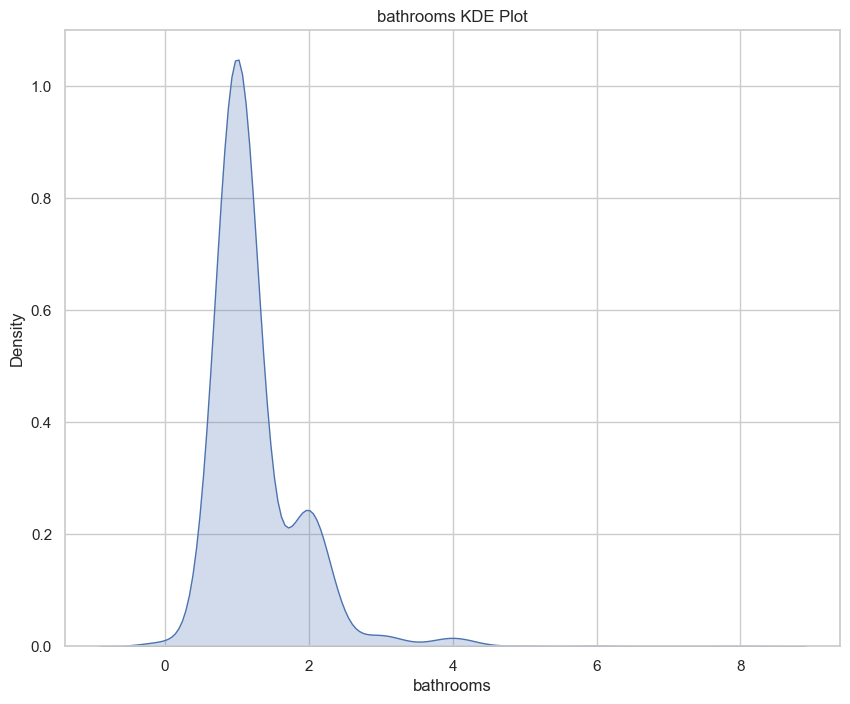

In [81]:
plot_kde(df, column='bathrooms', shade=True, color="b", bw_method=0.5, ylabel="Density")

#### Calculating skewness


In [82]:
analyze_skewness(df, column='bathrooms')

Skewness of the dataset: 3.475813822494678
The distribution is highly right-skewed.


#### Data is Missing at Random (MAR)

 - The data is highly right skewed(as it can amplify skewness) & continuous distribution, so using random imputation not best choice
 - Iam going with Mode imputation
 - In future i will use model based imputation for now iam going with mode

In [83]:
df = knn_impute(df, 'bathrooms', n_neighbors=5)

In [87]:
df['bathrooms']

0        1
1        1
2        1
3        1
4        1
        ..
74106    1
74107    2
74108    1
74109    1
74110    1
Name: bathrooms, Length: 74111, dtype: int32

#### Checking for outliers

In [89]:
# check_outliers_freq_table(df,'bathrooms')
# check_outliers_iqr(df['bathrooms'])

#### **Report** :  
* Handled missing data using mode imputation (iwill use more advanced techniques in future notebook)
* By using frequency tables i saw there are no outliers


---

### Columns:  host_has_profile_pic host_identity_verified

#### replacing the null value with new category

In [90]:
# df[['host_has_profile_pic','host_identity_verified']].fillna('m',inplace=True)  This one is not working
# reason: the there was a change in synatx of null values hence it doesnt work


# m : Missing value
df[['host_has_profile_pic','host_identity_verified']] = df[['host_has_profile_pic','host_identity_verified']].replace(np.nan, 'm')


# Changed the names of the values
df[['host_has_profile_pic','host_identity_verified']] = df[['host_has_profile_pic','host_identity_verified']].replace({'t':True, 'f': False , 'm':"missing"})

#### Plotting the bar plot

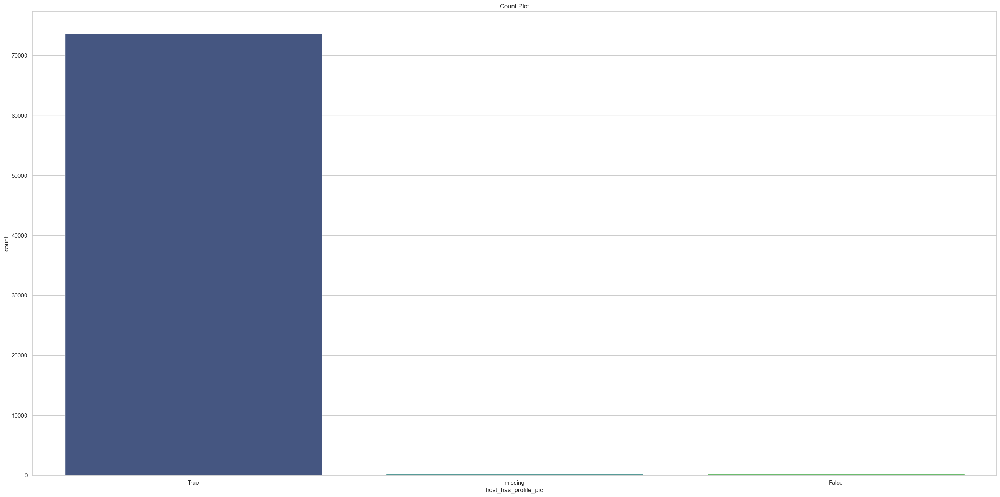

In [91]:
create_seaborn_countplot(df, 'host_has_profile_pic')

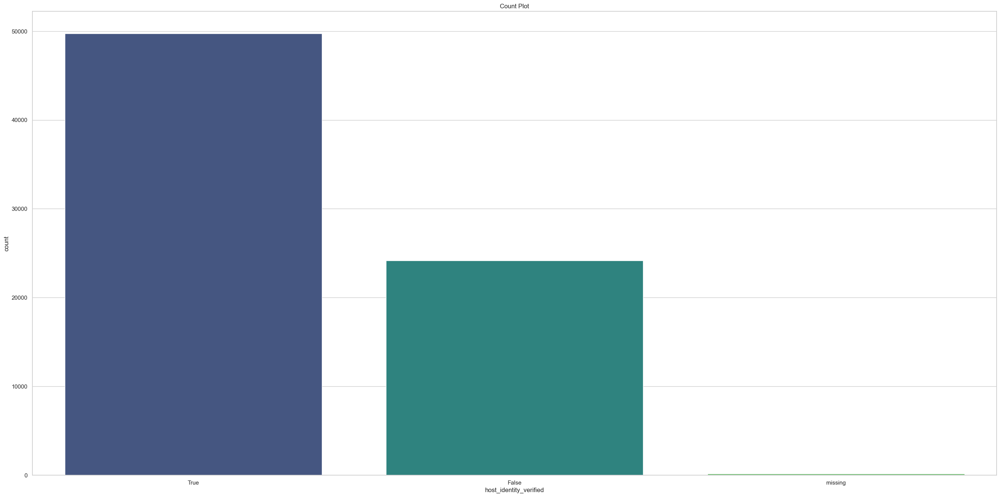

In [92]:
create_seaborn_countplot(df, 'host_identity_verified')

#### **Report**:
1. There are Equal missing values both columns
2. hence it is a categorical column if i use any other techniques for imputation it may leads lo bais
3. so i replace the null values with the new category
4. we can clearly see there are no outliers in the dataset

---

### Column Beds

#### column Bathrooms


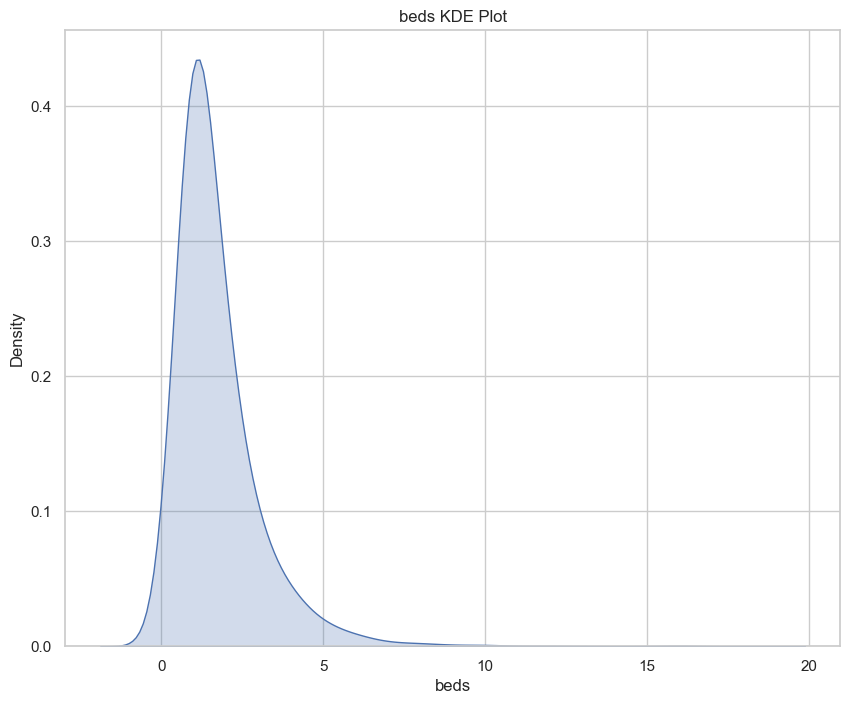

In [93]:
plot_kde(df, column='beds', shade=True, color="b", bw_method=0.5, ylabel="Density")

#### Calculating skewness


In [94]:
analyze_skewness(df, column='beds')

Skewness of the dataset: 3.358000200663669
The distribution is highly right-skewed.


#### Mode Imputing

In [95]:
df = knn_impute(df, 'beds', n_neighbors=5)

#### check the outliers


In [97]:
# check_outliers_freq_table(df,'beds')
# check_outliers_iqr(df['beds'])

---

### Column Bedroom

#### Plotting KDE for Bedrooms to know which impuation can be best

1.   List item
2.   List item




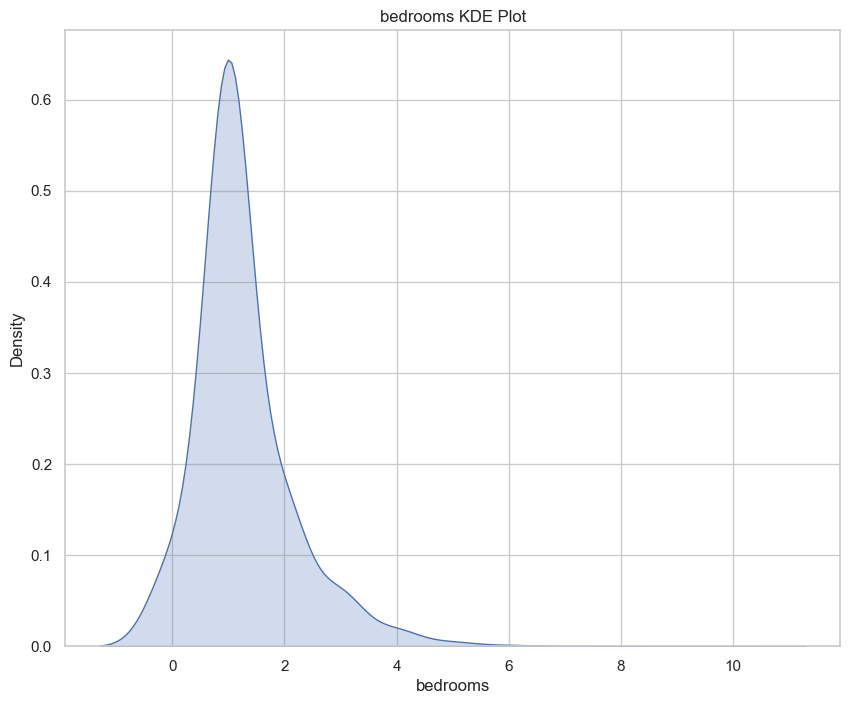

In [98]:
plot_kde(df, column='bedrooms', shade=True, color="b", bw_method=0.5, ylabel="Density")

#### Calculate skewness


In [99]:
analyze_skewness(df, column='bedrooms')

Skewness of the dataset: 1.989848743689331
The distribution is highly right-skewed.


#### Mode Imputing

In [100]:
df = knn_impute(df, 'bedrooms', n_neighbors=5)

#### Checking outliers

In [102]:
# check_outliers_freq_table(df,'bedrooms')

# check_outliers_iqr(df['bedrooms'])

#### **Report** :  
* Handled missing data using mode imputation (iwill use more advanced techniques in future notebook)
* By using frequency tables i saw there are no outliers


---

In [103]:
df['review_scores_rating'].value_counts()

100.0    16215
98.0      4374
97.0      4087
96.0      4081
95.0      3713
93.0      3647
90.0      2852
99.0      2631
94.0      2618
80.0      2163
92.0      2064
91.0      1615
89.0      1120
87.0      1119
88.0      1056
85.0       625
86.0       512
60.0       444
84.0       438
83.0       403
82.0       211
70.0       196
73.0       157
81.0       126
75.0       101
20.0        97
78.0        94
40.0        90
79.0        83
76.0        76
77.0        74
67.0        66
74.0        39
72.0        38
50.0        30
65.0        28
68.0        20
71.0        14
69.0        13
63.0        11
53.0        10
64.0        10
47.0         5
30.0         4
62.0         3
66.0         3
55.0         3
57.0         3
27.0         2
35.0         1
49.0         1
58.0         1
54.0         1
56.0         1
Name: review_scores_rating, dtype: int64

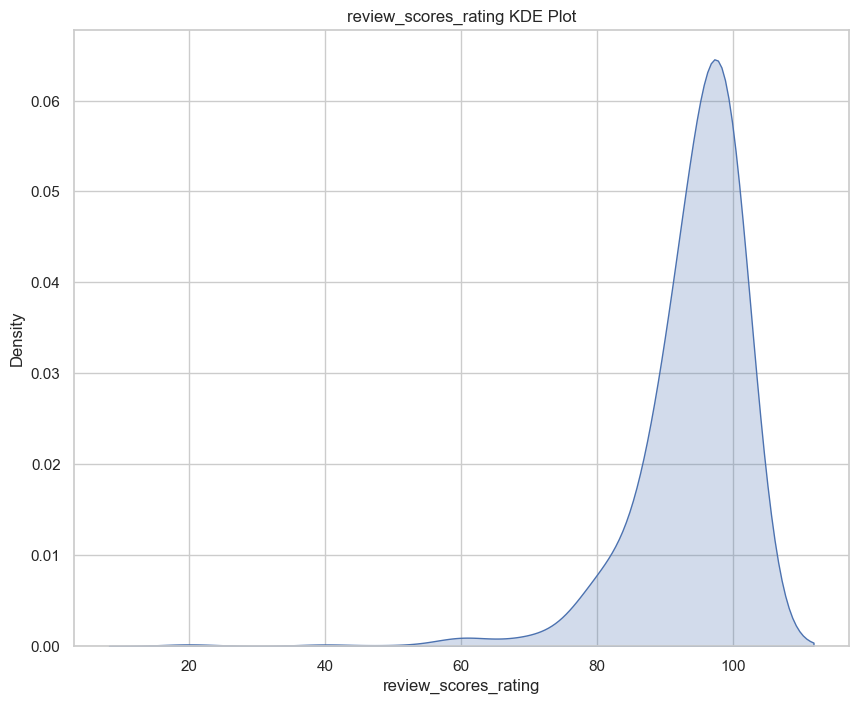

In [104]:
plot_kde(df, column='review_scores_rating', shade=True, color="b", bw_method=0.5, ylabel="Density")

In [105]:
analyze_skewness(df, column='review_scores_rating')

Skewness of the dataset: -3.3808606233341605
The distribution is highly left-skewed.


In [106]:
df = knn_impute(df, 'review_scores_rating', n_neighbors=5)

---

### column Thumbnail_url

In [107]:
# df = df.drop('thumbnail_url', axis=1)

#### **Report**


Droping this column because it has no significance in the dataset

---

### column Host_response_rate

In [108]:
df['host_response_rate'] = df['host_response_rate'].str.split("%").str[0]

In [109]:
df = random_imputation(df, column='host_response_rate')


In [110]:
df['host_response_rate'] =  df['host_response_rate'].astype('int')

#### **Report**:

Hence data is continous so better to use random imputation becasuse it adds less bais

---

### Datetime columns

In [111]:
df[['last_review','host_since','first_review']]

,last_review,host_since,first_review
0,7/18/2016,3/26/2012,6/18/2016
1,9/23/2017,6/19/2017,8/5/2017
2,9/14/2017,10/25/2016,4/30/2017
3,NaN,4/19/2015,NaN
4,1/22/2017,3/1/2015,5/12/2015
...,...,...,...
74106,NaN,3/24/2013,NaN
74107,4/15/2017,5/3/2016,8/15/2016
74108,9/10/2017,1/5/2012,1/3/2015
74109,NaN,9/17/2017,NaN


In [112]:
# Convert multiple columns to datetime format
df[['last_review', 'host_since', 'first_review']] = df[['last_review', 'host_since', 'first_review']].apply(pd.to_datetime)

In [113]:
df[['last_review', 'host_since', 'first_review']].isnull().sum()

last_review     15827
host_since        188
first_review    15864
dtype: int64

In [114]:
# Forward fill missing datetime values
df['last_review'] = df['last_review'].fillna(method='ffill')
df['host_since'] = df['host_since'].fillna(method='ffill')
df['first_review'] = df['first_review'].fillna(method='ffill')

#### **Report**:

since all the columns are datetime

in the begining i used mode imputation but i dont think it is suitable for that task soo

i used forward fill (each missing value is replaced with the last observed non-null value in the same column)


---

# Feature Engineering

## Extracting Information from Date Columns:


`first_review and last_review`: Extract features such as review duration or time since last review.

`host_since`: Calculate the tenure of the host.

In [115]:
# Feature engineering for review duration
# Calculate the duration between the first and last review for each listing, in days
df['review_duration'] = (df['last_review'] - df['first_review']).dt.days

# Feature engineering for time since last review
# Calculate the number of days since the last review was posted
df['time_since_last_review'] = (pd.to_datetime('today') - df['last_review']).dt.days

# Feature engineering for host tenure
# Calculate the tenure of each host measured in days since they joined the platform
df['host_tenure'] = (pd.to_datetime('today') - df['host_since']).dt.days


## Combining Features:
`number_of_reviews` and `review_scores_rating`: Calculate a new feature representing the average review score.

In [116]:
# Calculate the average review score for each number_of_reviews group
average_review_score = df.groupby('number_of_reviews')['review_scores_rating'].mean().reset_index()
average_review_score.rename(columns={'review_scores_rating': 'average_review_score'}, inplace=True)

# Merge the average_review_score back to the original DataFrame
df = pd.merge(df, average_review_score, on='number_of_reviews', how='left')

##  Extracting the new columns from amenities
Extract information from the amenities list, such as the count of amenities or specific amenities present.

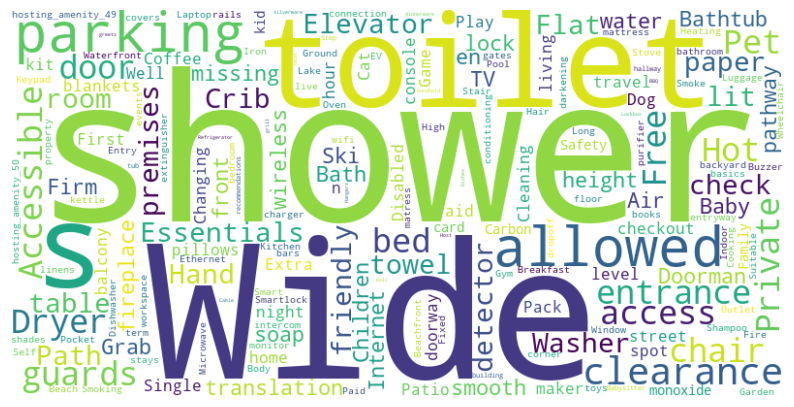

In [117]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Function to extract amenities from JSON string
def extract_amenities(amenities_str):
    # Remove braces and quotes, then split by comma to get individual amenities
    amenities = amenities_str.strip('{}').replace('"', '').split(',')
    return amenities

# Extract amenities from all rows and collect unique amenities into a set
all_amenities = set()
for amenities_str in df['amenities']:
    amenities_list = extract_amenities(amenities_str)
    all_amenities.update(amenities_list)

# Create a string with all amenities separated by spaces
amenities_text = ' '.join(all_amenities)

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color ='white').generate(amenities_text)

# Display the generated word cloud
plt.figure(figsize=(10, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [118]:
def count_amenities(amenities_str):
    """
    Function to count the number of amenities
    """
    # Remove braces and quotes, then split by comma to get individual amenities
    amenities = amenities_str.strip('{}').replace('"', '').split(',')
    return len(amenities)

# Count the number of amenities for each listing
df['amenities_count'] = df['amenities'].apply(count_amenities)

In [119]:
def extract_amenities(amenities_str):
    """
    Extracts amenities from a JSON string and creates a list of all amenities.

    Parameters:
    amenities_str (str): JSON string containing amenities.

    Returns:
    list: List of amenities extracted from the JSON string.
    """
    amenities = amenities_str.strip('{}').replace('"', '').split(',')
    return amenities

# Extract all amenities and create a list of all amenities across all listings
all_amenities = []
for amenities_str in df['amenities']:
    all_amenities.extend(extract_amenities(amenities_str))

# Calculate the frequency of each amenity
amenities_frequency = pd.Series(all_amenities).value_counts()

# Select the top 5 most common amenities
top_5_amenities = amenities_frequency.head(5).index.tolist()

print("Top 5 most common amenities:")
print(top_5_amenities)

# copying the list of important amenities
important_amenities = top_5_amenities

def check_important_amenity(amenities_str, important_amenity):
    """
    Checks if an important amenity is present in the amenities string.

    Parameters:
    amenities_str (str): String containing amenities.
    important_amenity (str): The important amenity to check for.

    Returns:
    int: 1 if the important amenity is present, 0 otherwise.
    """
    return 1 if important_amenity in amenities_str else 0

# Create binary columns for each important amenity with a prefix
prefix = 'has_'
for amenity in important_amenities:
    column_name = prefix + amenity.lower().replace(' ', '_')
    df[column_name] = df['amenities'].apply(lambda x: check_important_amenity(x, amenity))

Top 5 most common amenities:
['Wireless Internet', 'Kitchen', 'Heating', 'Essentials', 'Smoke detector']


---

# Exploratory Data Analysis (EDA)

## Univarint Analysis

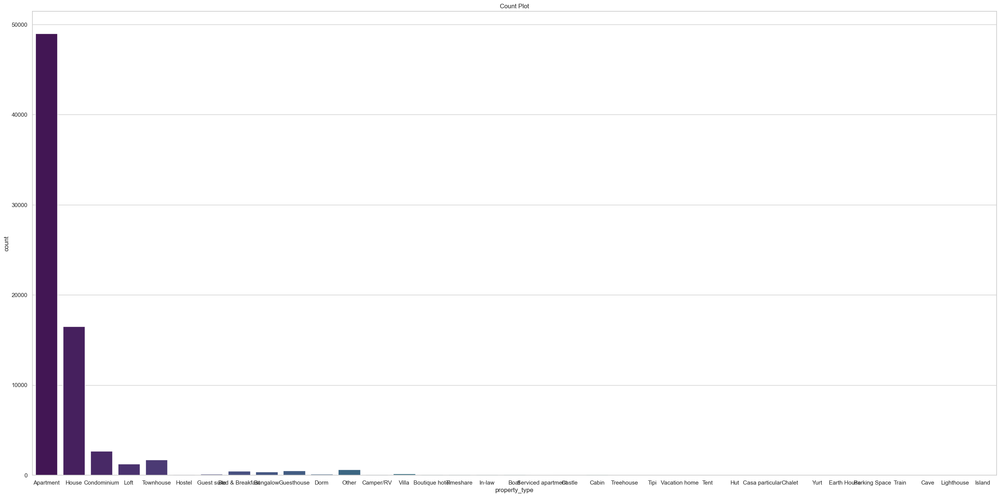

In [120]:
create_seaborn_countplot(df, 'property_type')

### **Report**:

> - as we can see Apartment,House,condominium are top 3 properties; obviously reasons is most of the type of property are apartments in cities

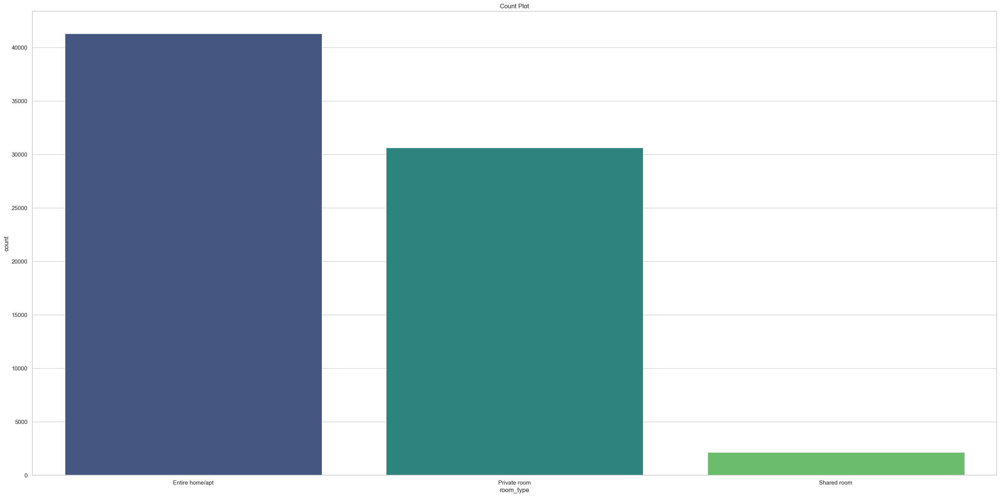

In [121]:
create_seaborn_countplot(df, 'room_type')

### **Report** :

> - family: choose entire home/apt
> - couples/singles: choose private room
> - friends : shared rooms

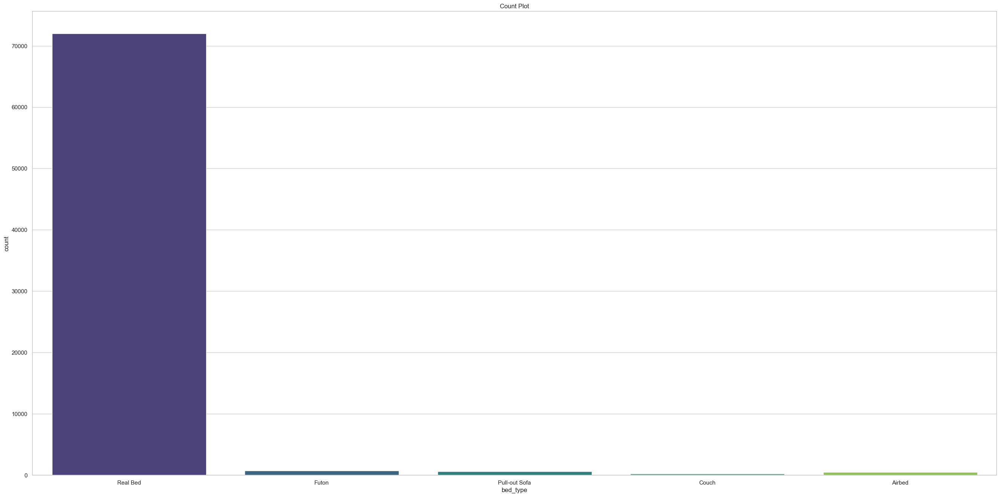

In [122]:
create_seaborn_countplot(df, 'bed_type')

### **Report**:

> We can see almost 97% rooms/homes are equiped with realbeds

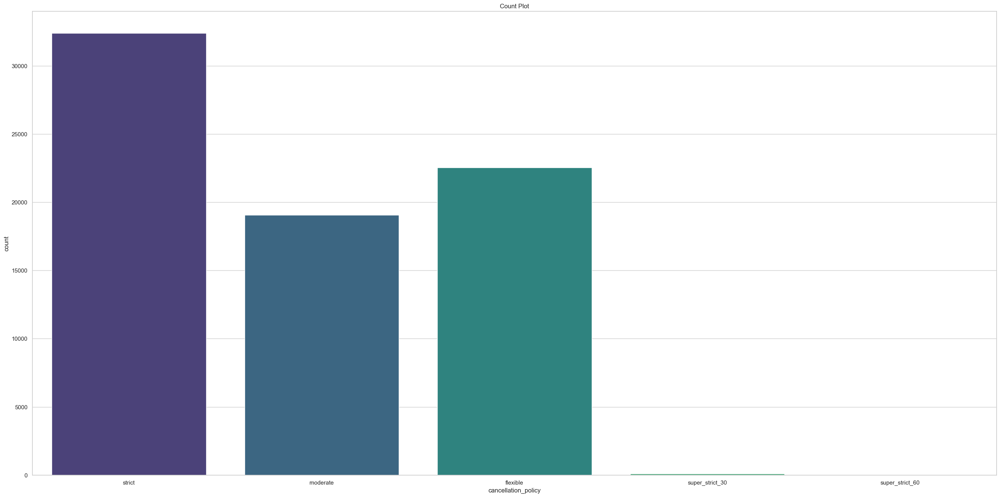

In [123]:
create_seaborn_countplot(df, 'cancellation_policy')

### **Report**:

> we can observe there are 5levels of different cancellation policecs among them `strict, moderate & flexible` are more

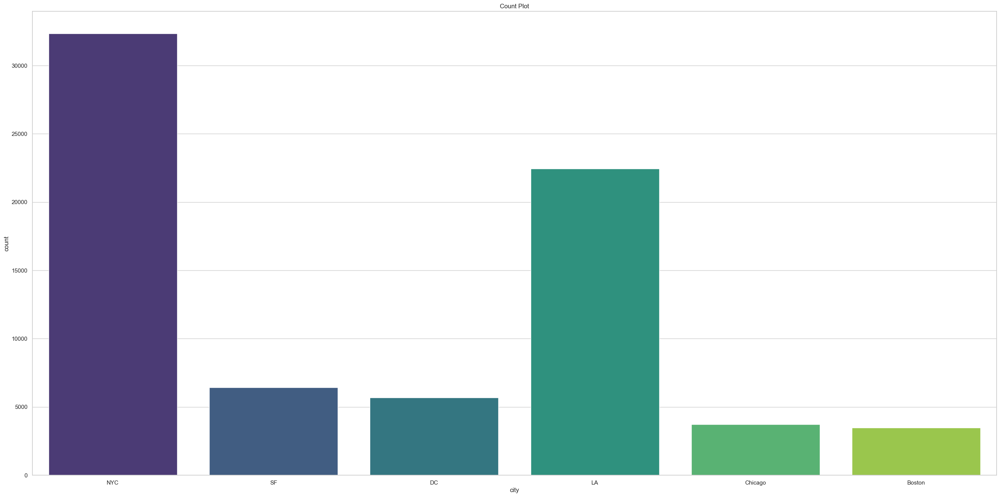

In [124]:
create_seaborn_countplot(df, 'city')

### **Report**:

> Newyork city is most of the apartments/homes fallowed by Los angels

> san francisco - DC - have some what equal shares

> chicago & Boston also shares equal in numbers

In [125]:
df['zipcode'] = df['zipcode'].str.split("-").str[0].str[:].str.split("\r").str[0]

# print('55555-57484\r\r\r\r\r\r\n\r\r\r\r\r\r\n\r\r\r\r\r\r\n94158'.split("-")[0].split("\r").str[0]) #Sample viz of above code

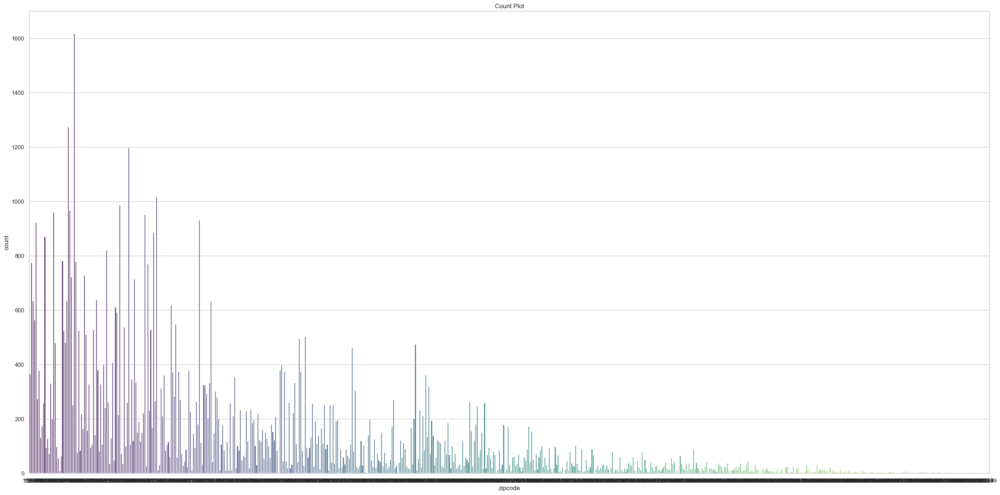

In [126]:
create_seaborn_countplot(df, 'zipcode')

### **Report**

> we can observe wide range of irregular pattern in the zipline count plot

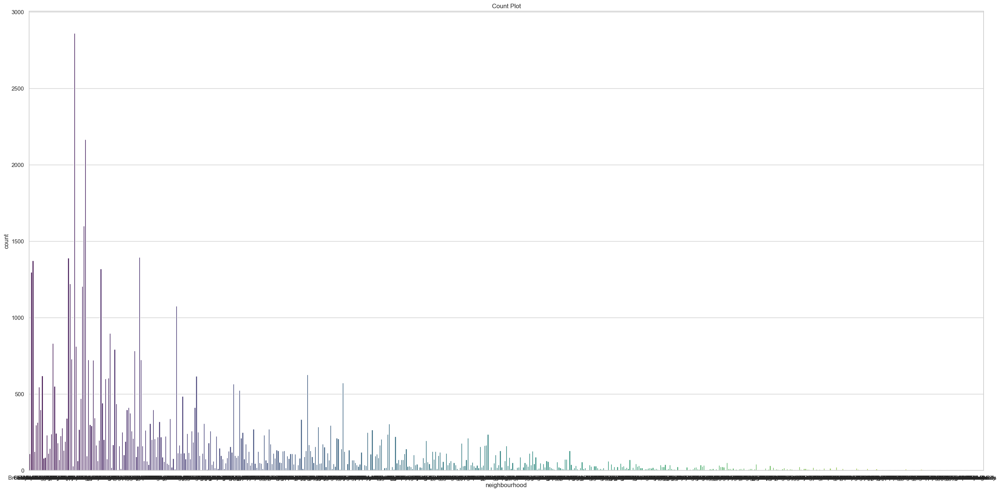

In [127]:
create_seaborn_countplot(df, 'neighbourhood')

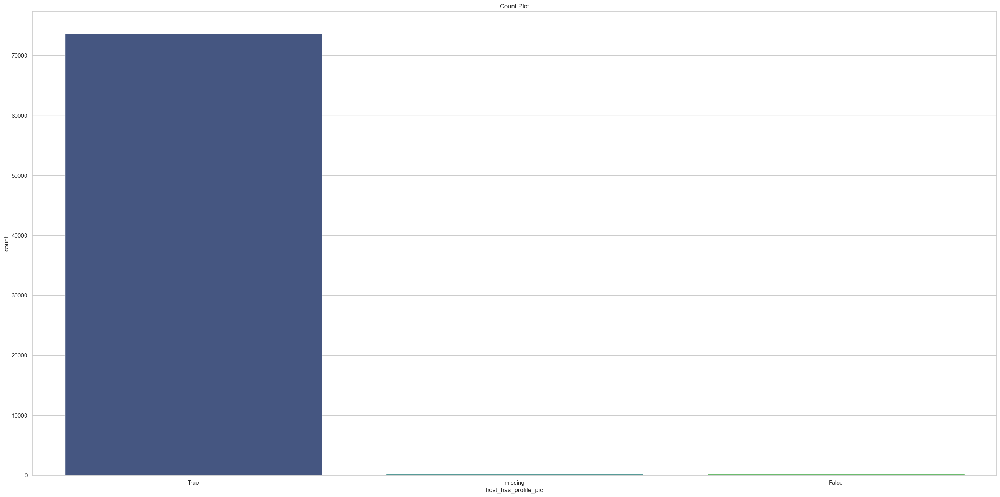

In [128]:
create_seaborn_countplot(df, 'host_has_profile_pic')

### **Report**

> most all them have profile pic

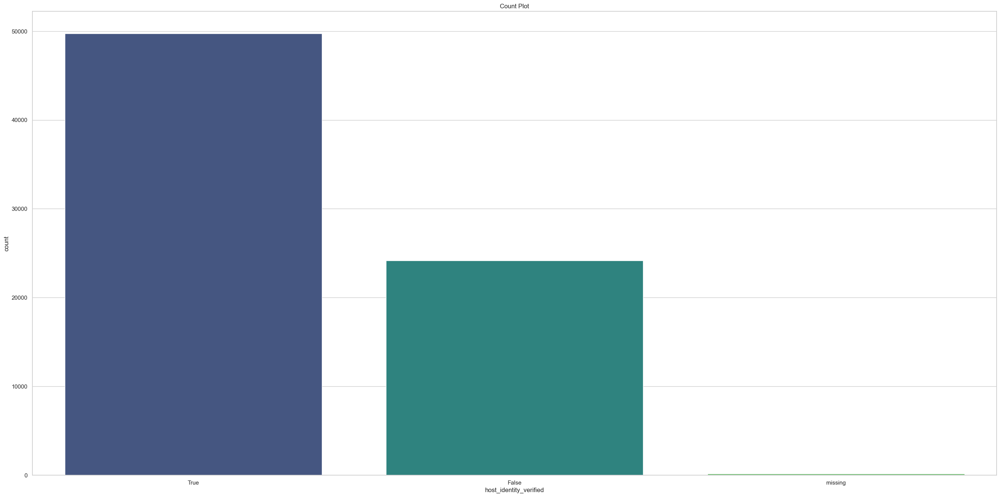

In [129]:
create_seaborn_countplot(df, 'host_identity_verified')

### **Report**:

> Most the hosts are verifed(49.0k) and some them are not verified(24k)

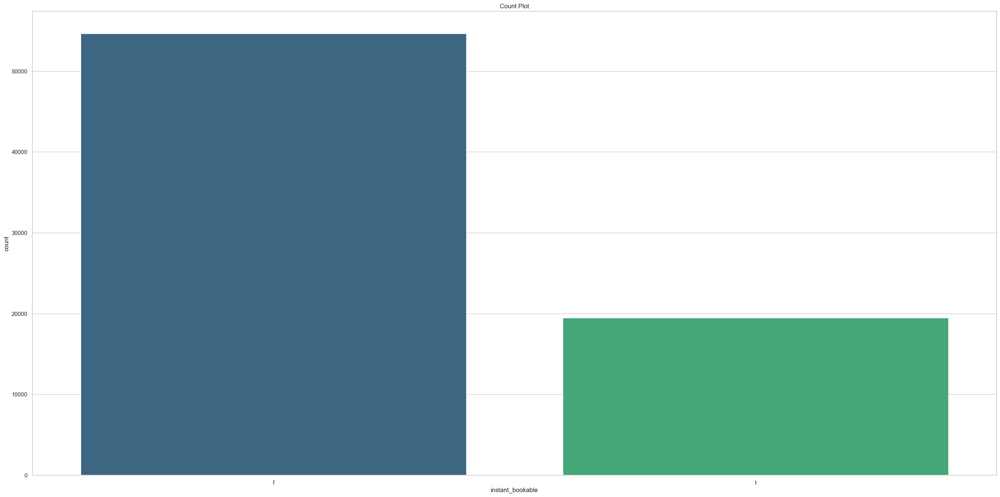

In [130]:
create_seaborn_countplot(df, 'instant_bookable')

### **Report**:

> Nearly 1/3 of them are not offering instanly bookable

In [131]:
df.select_dtypes(exclude='object').describe()

,id,log_price,accommodates,bathrooms,host_response_rate,latitude,longitude,number_of_reviews,review_scores_rating,bedrooms,...,amenities_count,has_wireless_internet,has_kitchen,has_heating,has_essentials,has_smoke_detector,review_duration,time_since_last_review,host_tenure,average_review_score
count,7.411100e+04,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,...,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000,74111.000000
mean,1.126662e+07,4.782069,3.155146,1.250624,94.326011,38.445958,-92.397525,20.900568,94.052165,1.265467,...,17.602407,0.961598,0.911147,0.905034,0.863637,0.832899,425.806129,2610.258383,3577.994090,94.052165
std,6.081735e+06,0.717394,2.153589,0.597852,16.387421,3.080167,21.705322,37.828641,6.896060,0.851671,...,6.936947,0.192166,0.284534,0.293169,0.343176,0.373068,490.276735,231.118332,661.467516,0.414158
min,3.440000e+02,0.000000,1.000000,0.000000,0.000000,33.338905,-122.511500,0.000000,20.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1337.000000,2406.000000,2407.000000,86.000000
25%,6.261964e+06,4.317488,2.000000,1.000000,100.000000,34.127908,-118.342374,1.000000,93.000000,1.000000,...,13.000000,1.000000,1.000000,1.000000,1.000000,1.000000,52.000000,2433.000000,3059.000000,93.814894
50%,1.225415e+07,4.709530,2.000000,1.000000,100.000000,40.662138,-76.996965,6.000000,94.000000,1.000000,...,17.000000,1.000000,1.000000,1.000000,1.000000,1.000000,264.000000,2566.000000,3509.000000,94.000000
75%,1.640226e+07,5.220356,4.000000,1.000000,100.000000,40.746096,-73.954660,23.000000,99.000000,1.000000,...,22.000000,1.000000,1.000000,1.000000,1.000000,1.000000,622.500000,2675.000000,4035.000000,94.357104
max,2.123090e+07,7.600402,16.000000,8.000000,100.000000,42.390437,-70.985047,605.000000,100.000000,10.000000,...,86.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3106.000000,5585.000000,5909.000000,100.000000


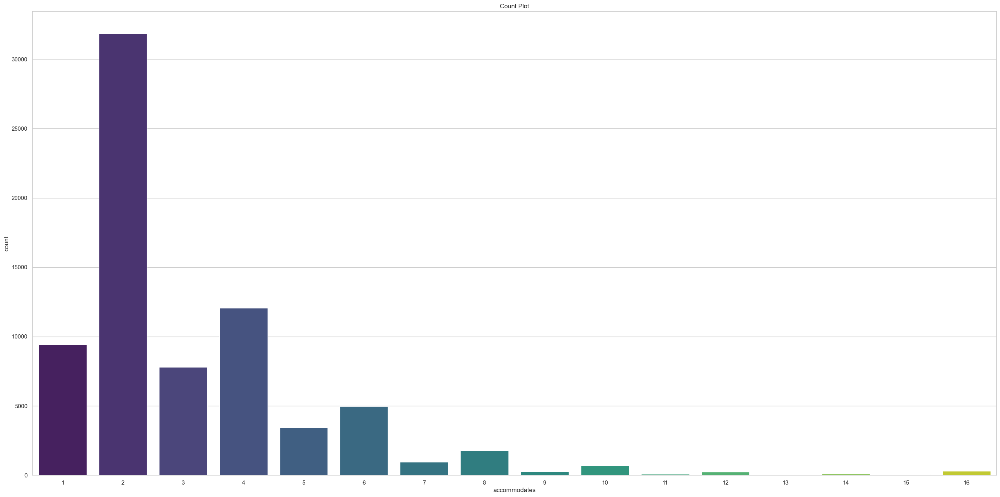

In [132]:
create_seaborn_countplot(df, 'accommodates')

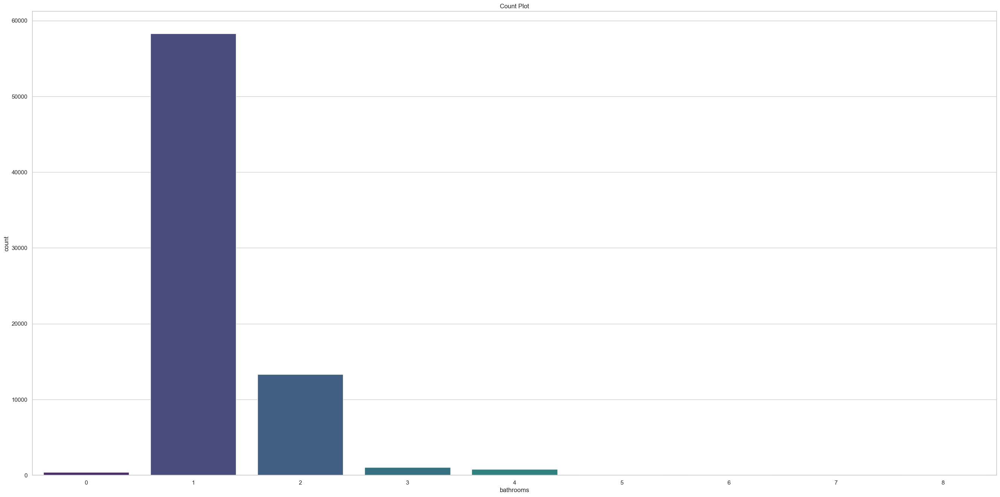

In [133]:
create_seaborn_countplot(df, 'bathrooms')

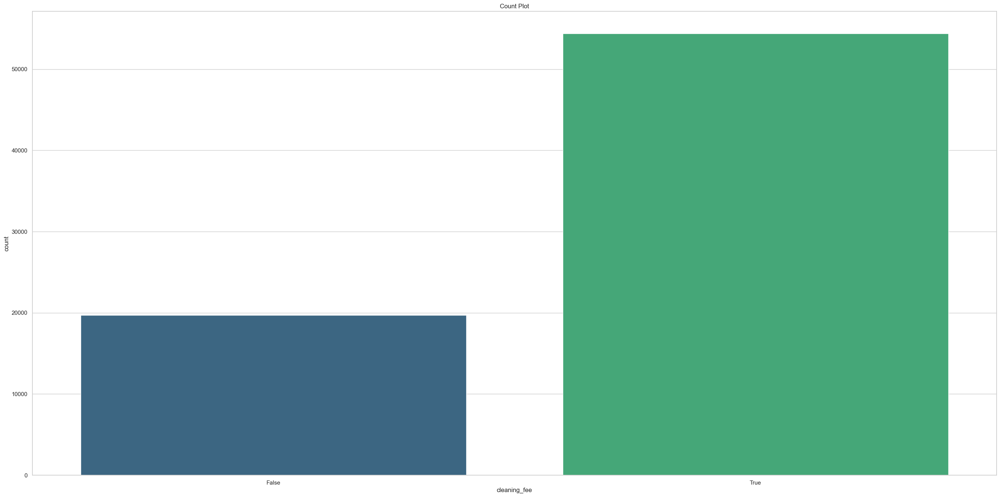

In [134]:
create_seaborn_countplot(df, 'cleaning_fee')

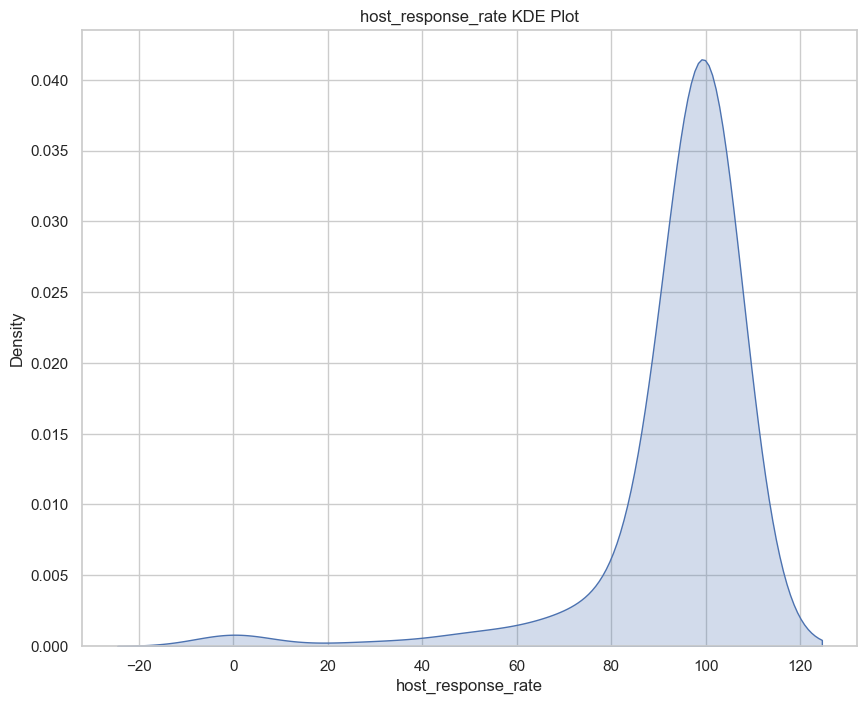

In [135]:
plot_kde(df, 'host_response_rate')

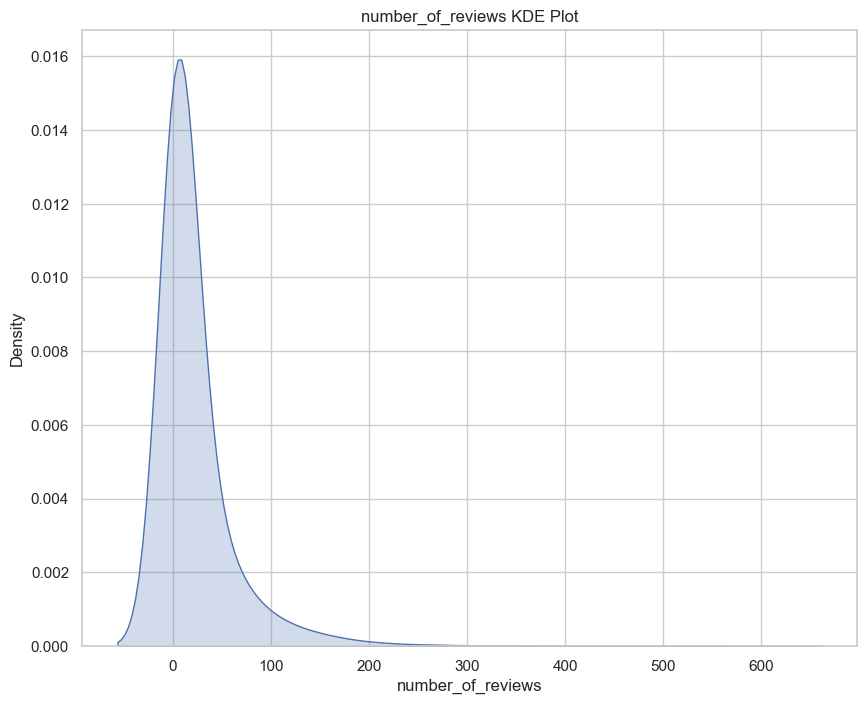

In [136]:
plot_kde(df, 'number_of_reviews')

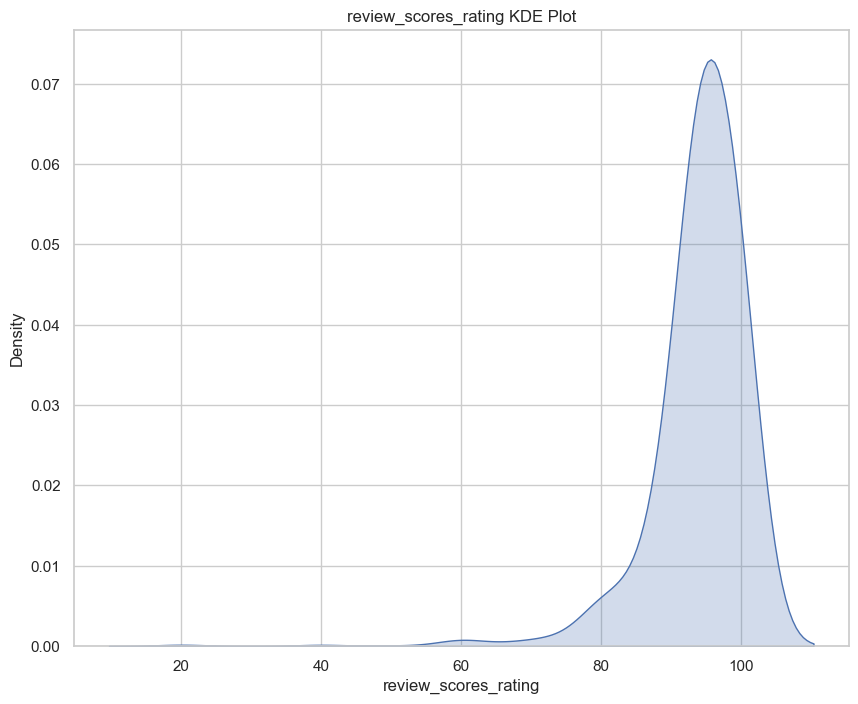

In [137]:
plot_kde(df, 'review_scores_rating')

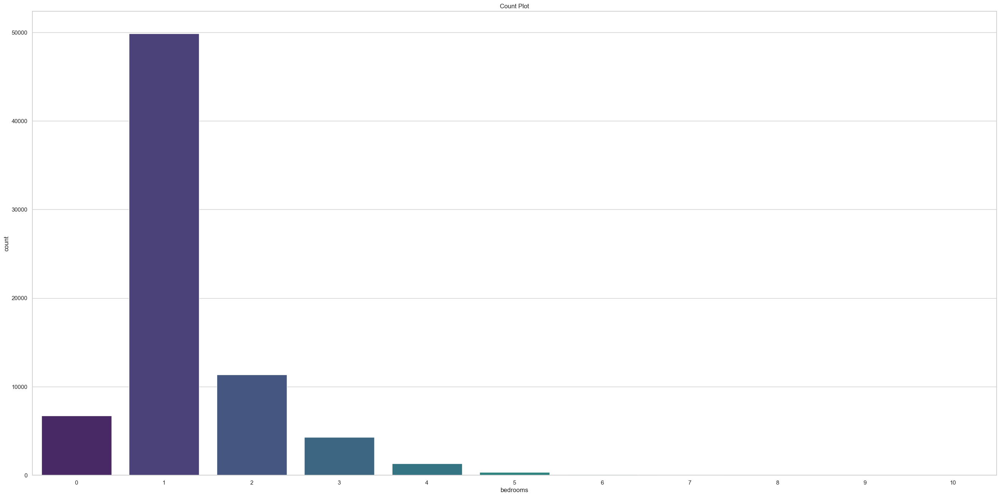

In [138]:
create_seaborn_countplot(df, 'bedrooms')

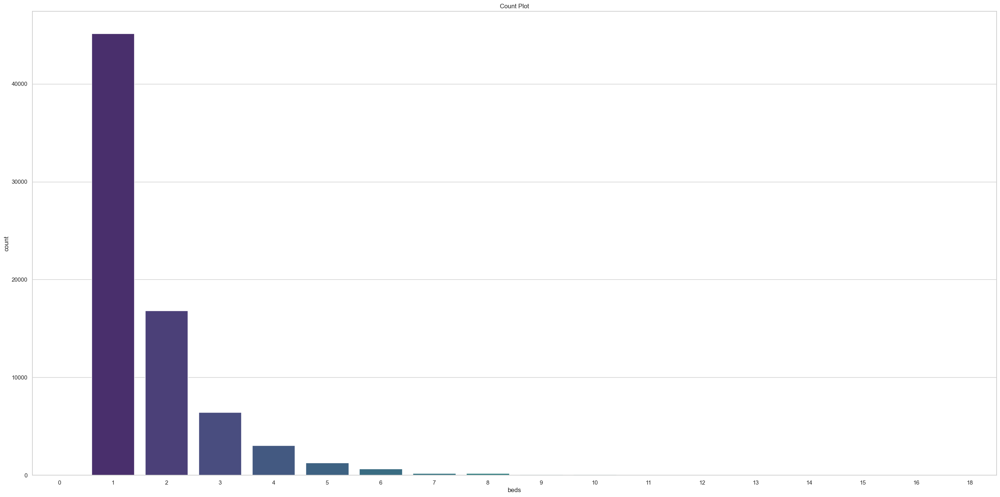

In [139]:
create_seaborn_countplot(df, 'beds')

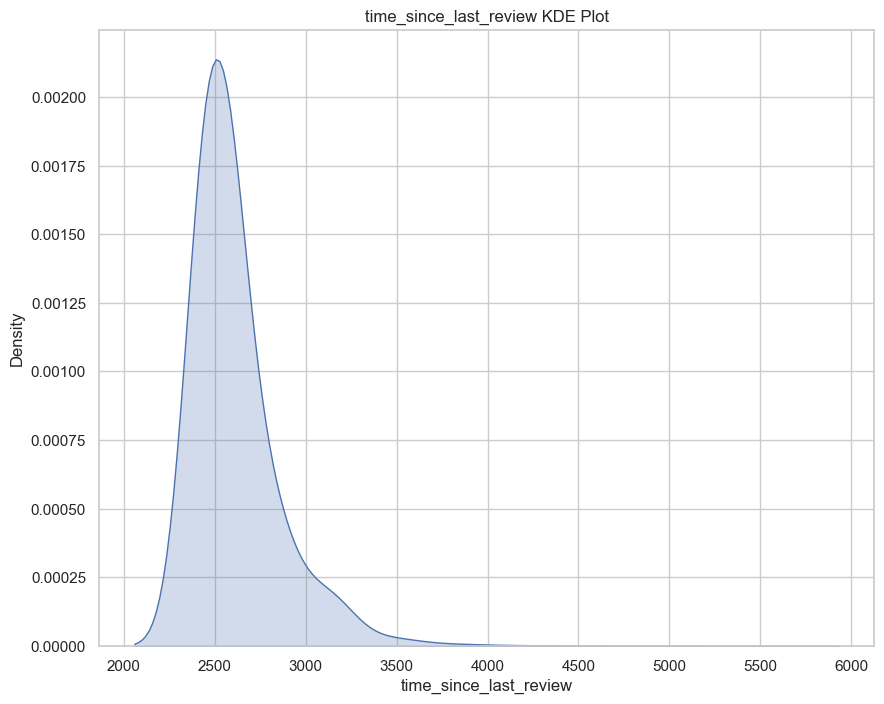

In [140]:

plot_kde(df, 'time_since_last_review')

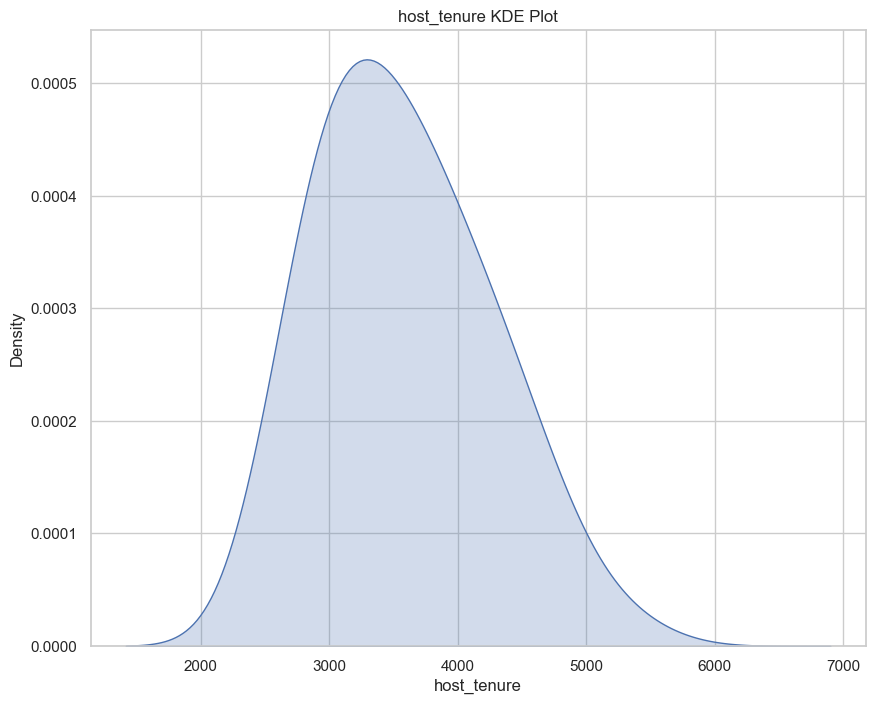

In [141]:
plot_kde(df, 'host_tenure')

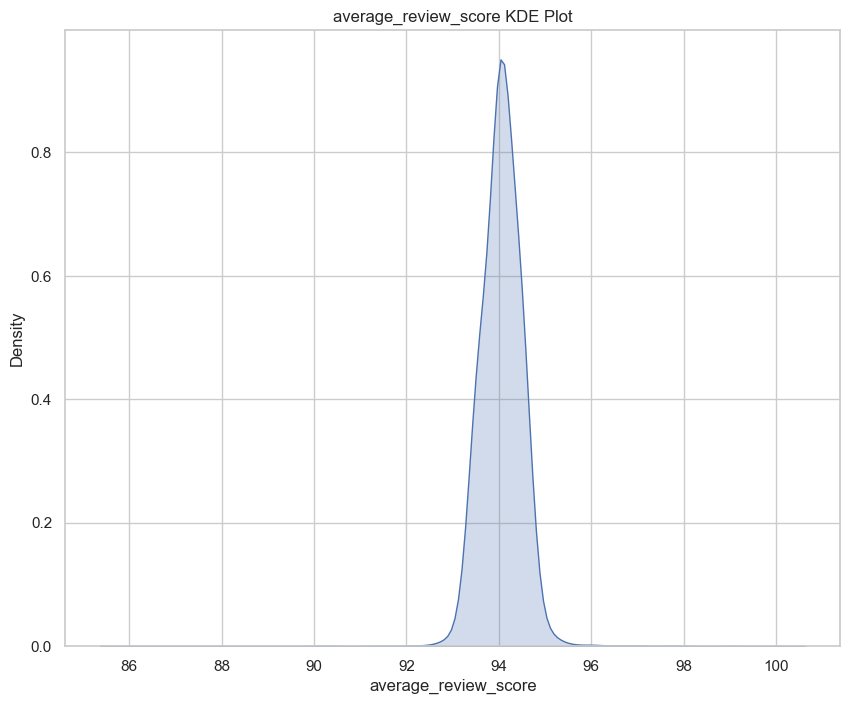

In [142]:
plot_kde(df, 'average_review_score')

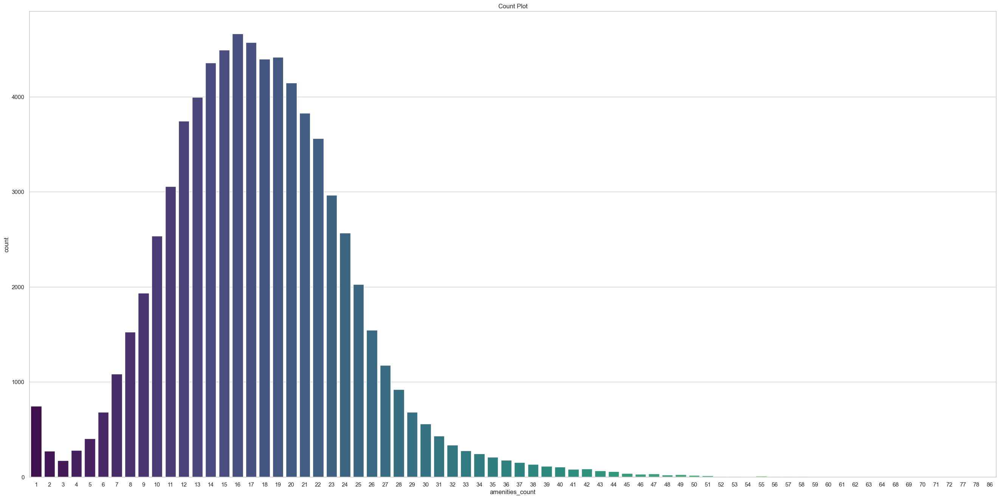

In [143]:
create_seaborn_countplot(df,'amenities_count' )

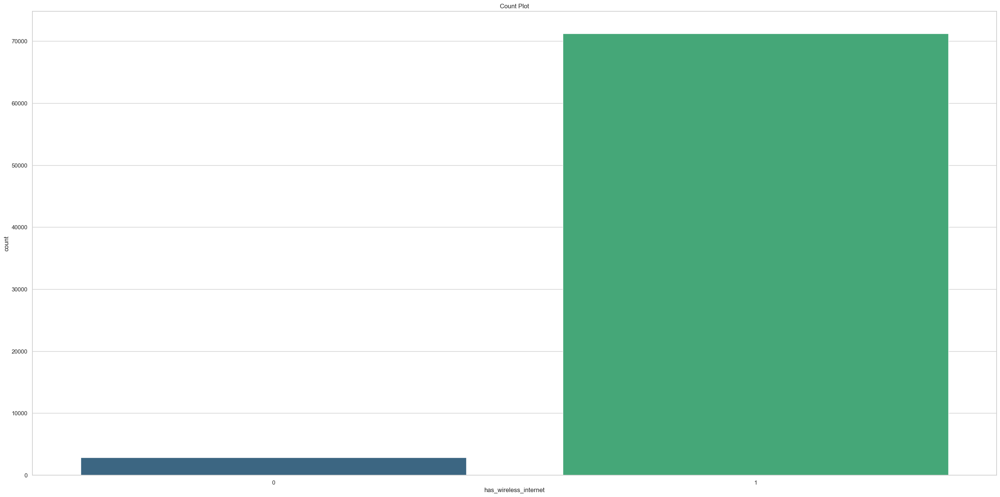

In [144]:
create_seaborn_countplot(df, 'has_wireless_internet')

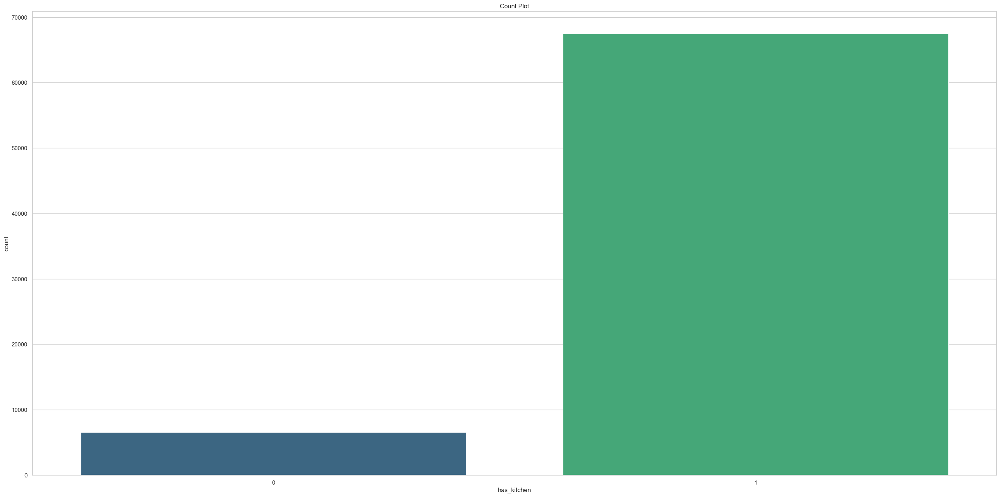

In [145]:
create_seaborn_countplot(df, 'has_kitchen')

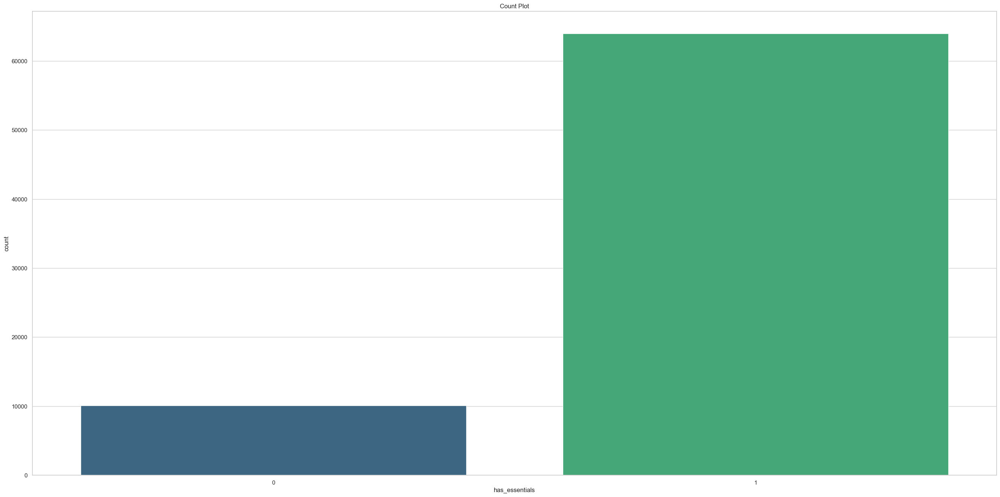

In [146]:
create_seaborn_countplot(df, 'has_essentials')

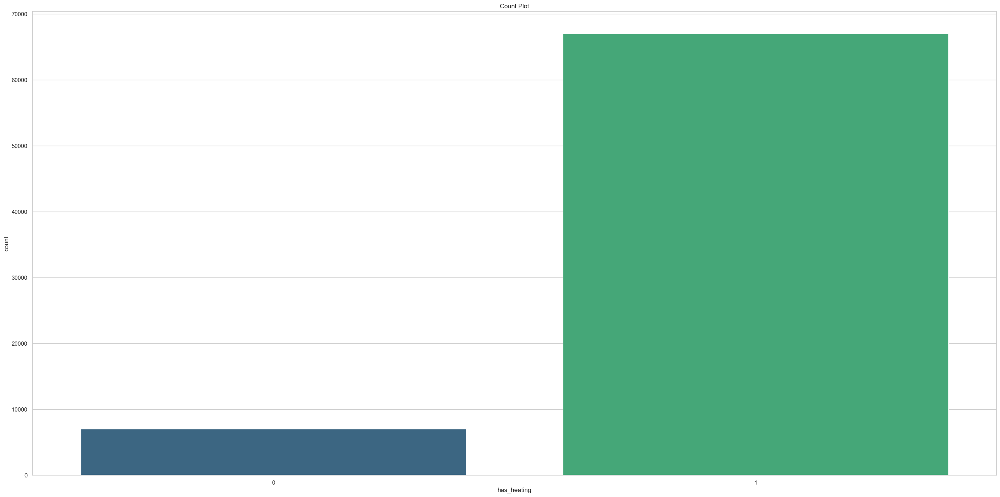

In [147]:
create_seaborn_countplot(df, 'has_heating')

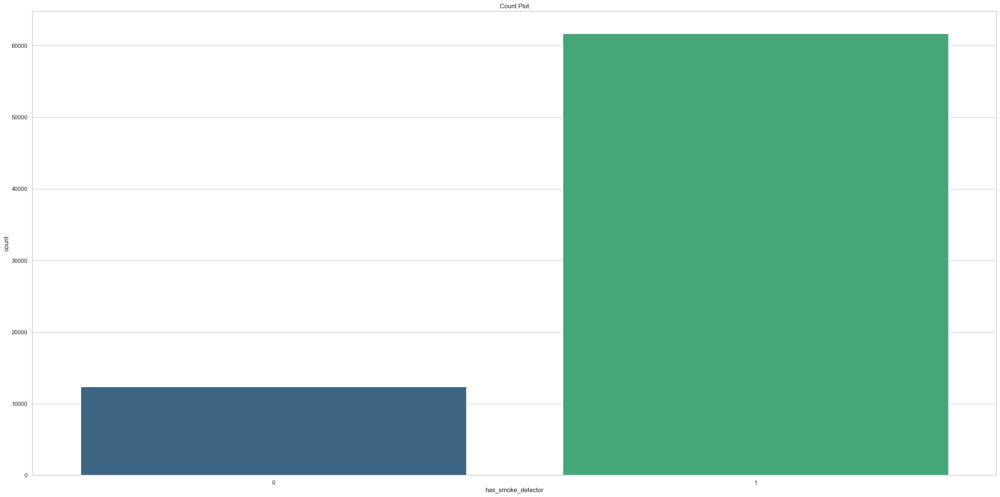

In [148]:
create_seaborn_countplot(df, 'has_smoke_detector')

## Bivarint Analysis

In [149]:
# Calculating the mean log price for each property type
mean_log_price_wrt_pt = df.groupby(df['property_type'])['log_price'].mean().to_frame().reset_index() # return the dataframe of property-type & mean log-price

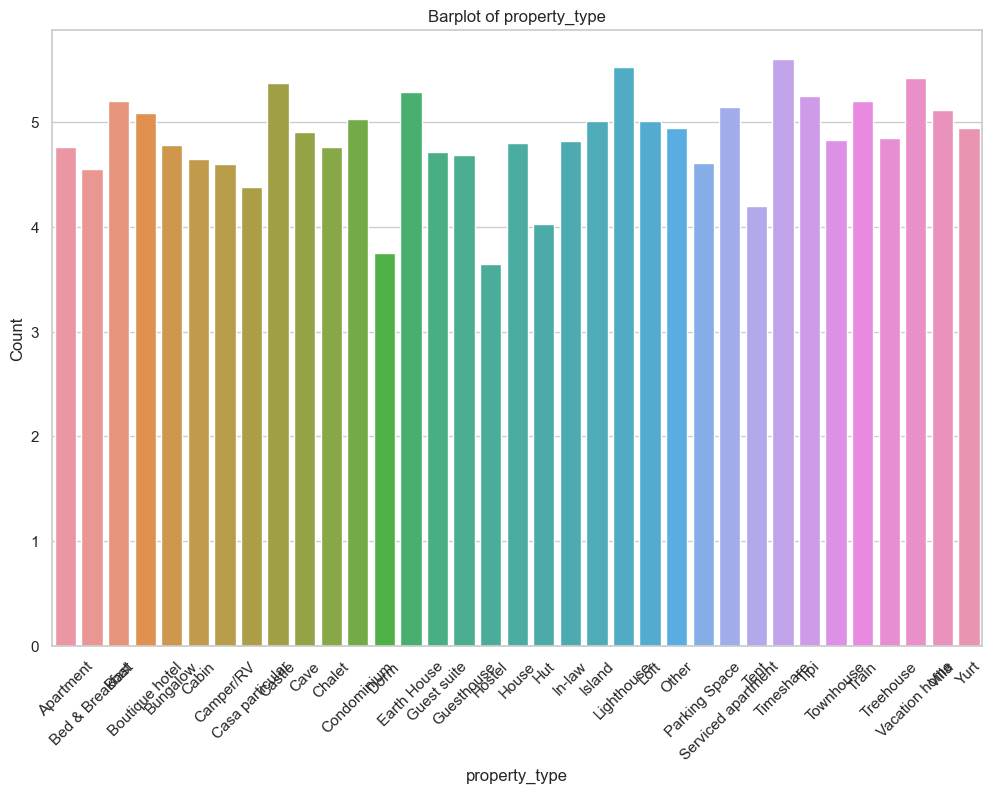

<AxesSubplot: title={'center': 'Barplot of property_type'}, xlabel='property_type', ylabel='Count'>

In [150]:
plot_barplot(mean_log_price_wrt_pt, 'property_type', 'log_price')

In [151]:
# Calculating the mean log price for each property type
mean_log_price_wrt_rt = df.groupby(df['room_type'])['log_price'].mean().to_frame().reset_index() # return the dataframe of property-type & mean log-price

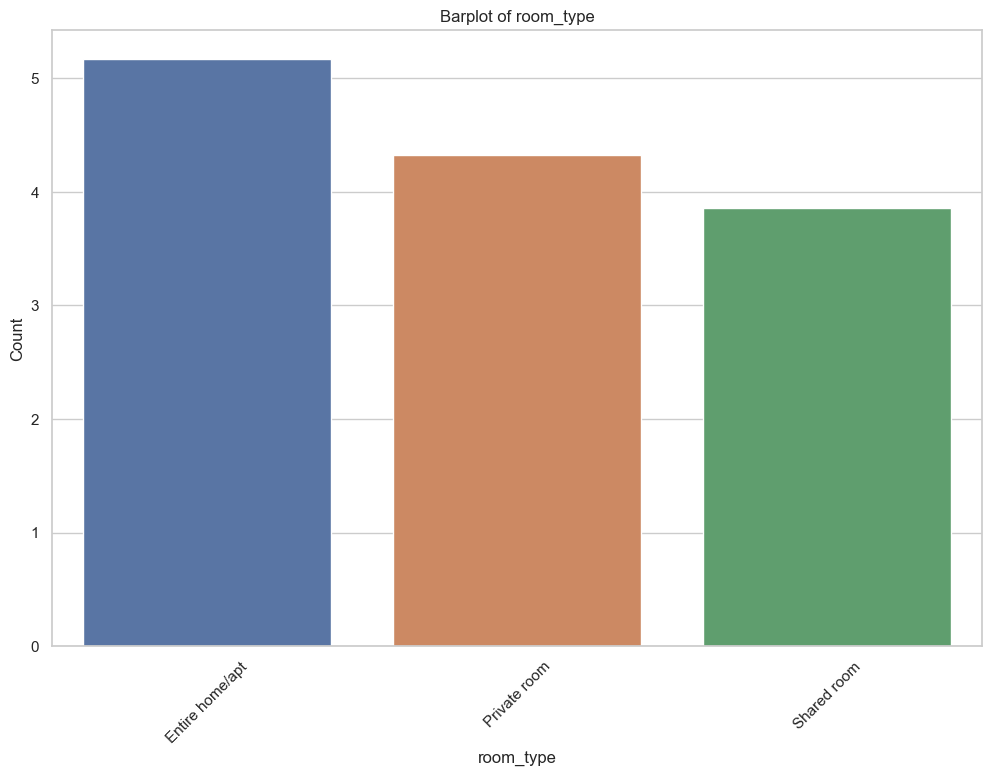

<AxesSubplot: title={'center': 'Barplot of room_type'}, xlabel='room_type', ylabel='Count'>

In [152]:
plot_barplot(mean_log_price_wrt_rt, 'room_type', 'log_price')

In [153]:
mean_log_price_wrt_acc = df.groupby(df['accommodates'])['log_price'].mean().to_frame().reset_index() # return the dataframe of accommodates & mean log-price

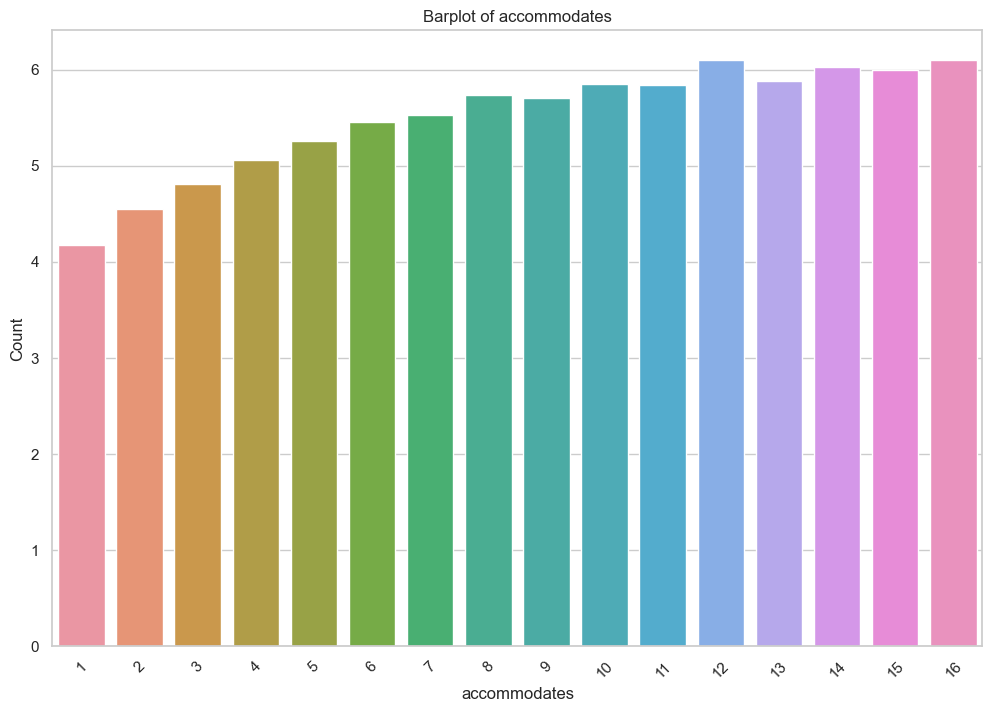

<AxesSubplot: title={'center': 'Barplot of accommodates'}, xlabel='accommodates', ylabel='Count'>

In [154]:
plot_barplot(mean_log_price_wrt_acc, 'accommodates', 'log_price')

In [155]:
mean_log_price_wrt_br = df.groupby(df['bathrooms'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

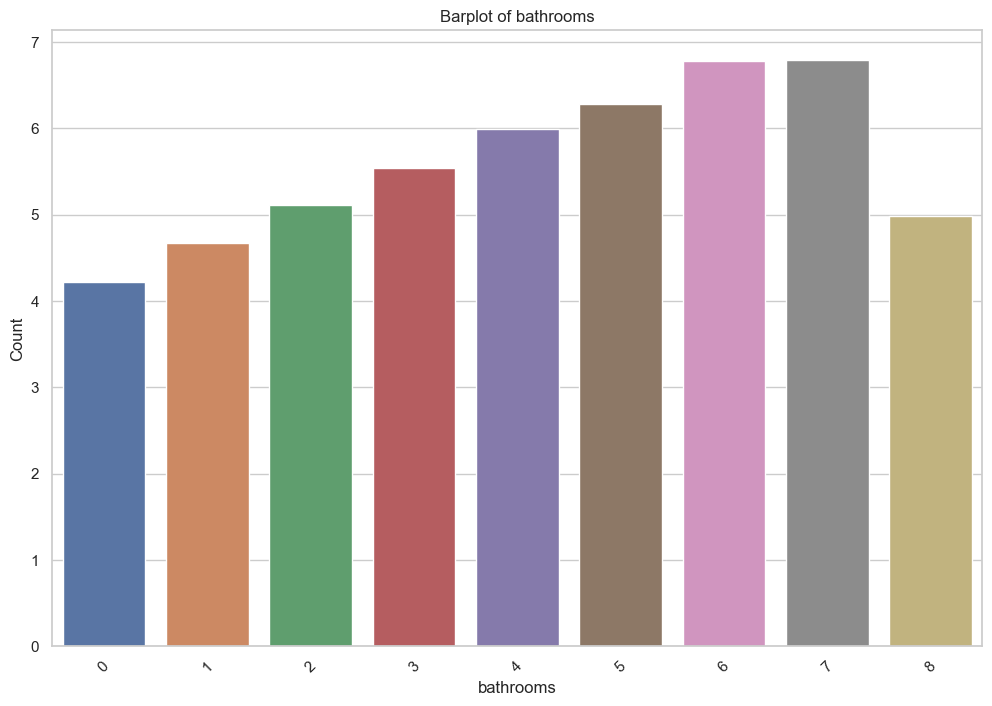

<AxesSubplot: title={'center': 'Barplot of bathrooms'}, xlabel='bathrooms', ylabel='Count'>

In [156]:
plot_barplot(mean_log_price_wrt_br, 'bathrooms', 'log_price')

In [157]:
mean_log_price_wrt_bt = df.groupby(df['bed_type'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

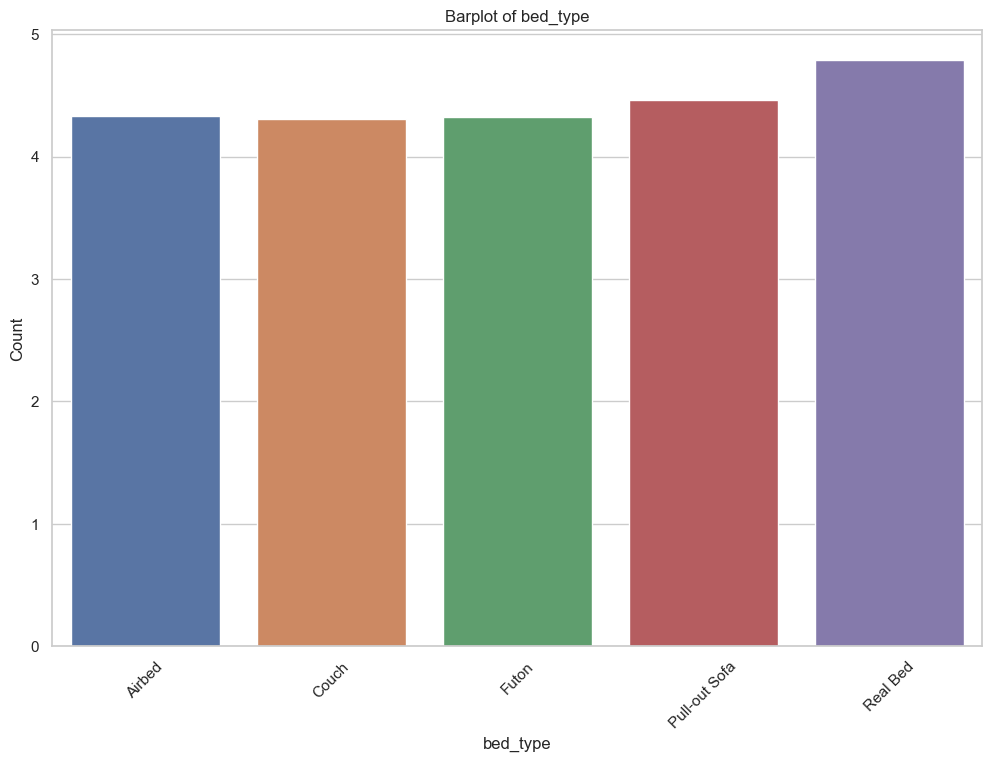

<AxesSubplot: title={'center': 'Barplot of bed_type'}, xlabel='bed_type', ylabel='Count'>

In [158]:
plot_barplot(mean_log_price_wrt_bt, 'bed_type', 'log_price')

In [159]:
mean_log_price_wrt_cp = df.groupby(df['cancellation_policy'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

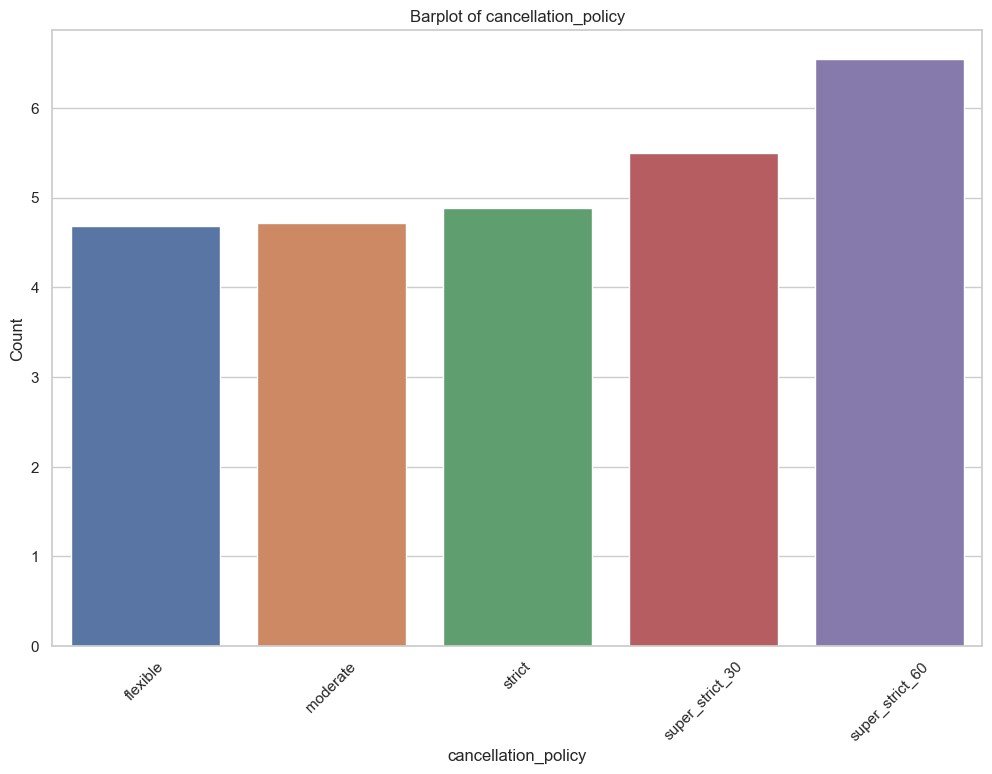

<AxesSubplot: title={'center': 'Barplot of cancellation_policy'}, xlabel='cancellation_policy', ylabel='Count'>

In [160]:
plot_barplot(mean_log_price_wrt_cp, 'cancellation_policy', 'log_price')

In [161]:
mean_log_price_wrt_cf = df.groupby(df['cleaning_fee'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

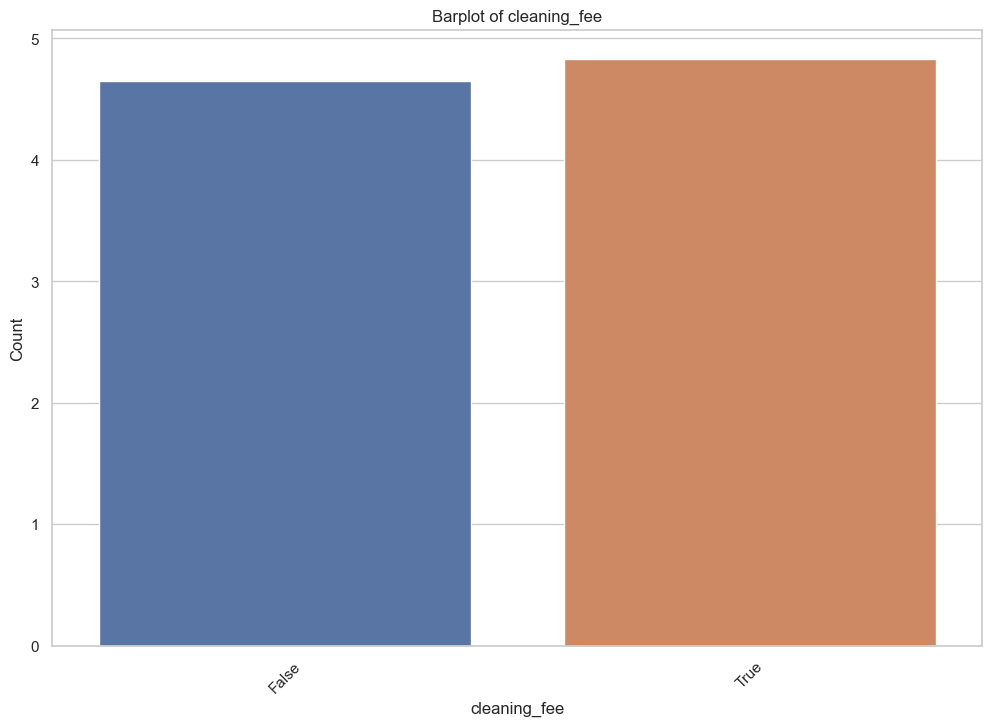

<AxesSubplot: title={'center': 'Barplot of cleaning_fee'}, xlabel='cleaning_fee', ylabel='Count'>

In [162]:
plot_barplot(mean_log_price_wrt_cf, 'cleaning_fee', 'log_price')

In [163]:
mean_log_price_wrt_ib = df.groupby(df['instant_bookable'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

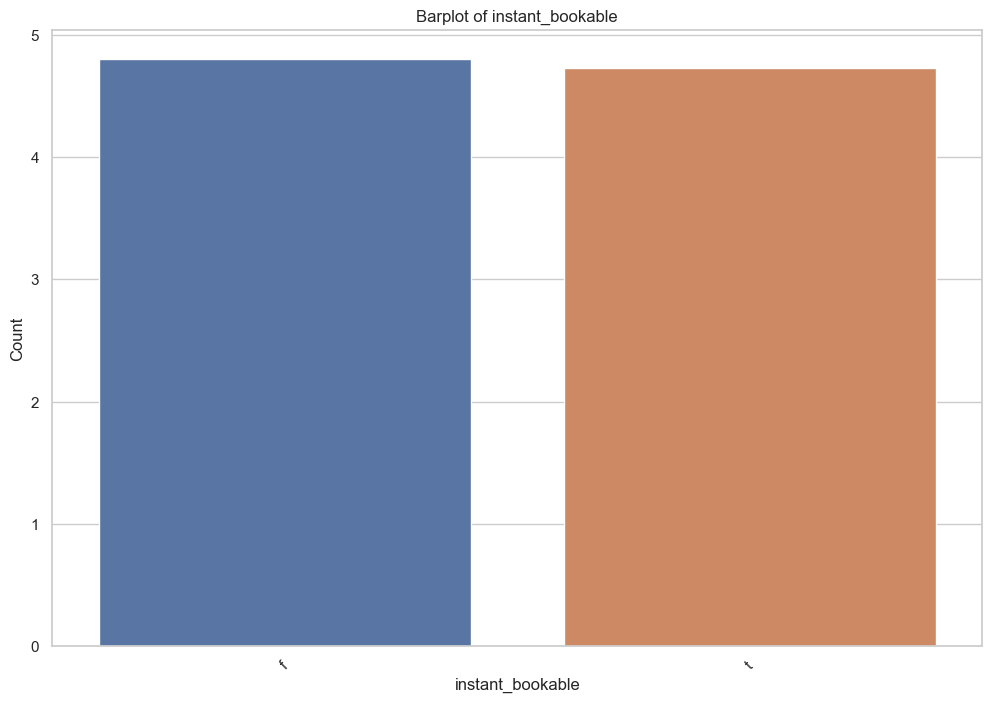

<AxesSubplot: title={'center': 'Barplot of instant_bookable'}, xlabel='instant_bookable', ylabel='Count'>

In [164]:
plot_barplot(mean_log_price_wrt_ib, 'instant_bookable', 'log_price')

In [165]:
mean_log_price_wrt_cty = df.groupby(df['city'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

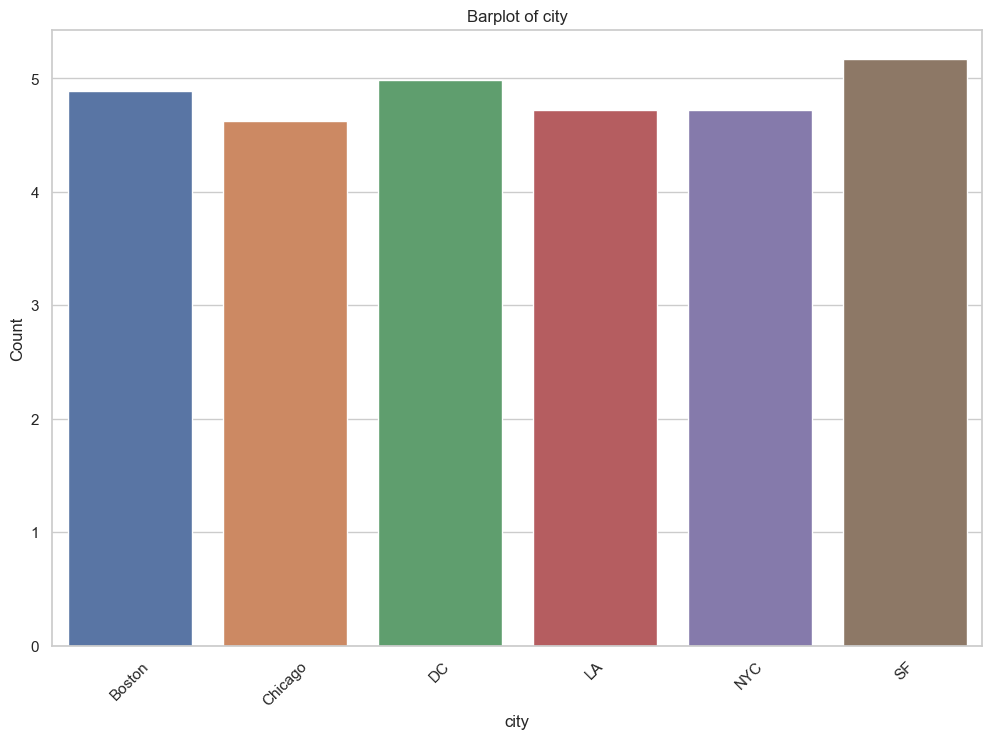

<AxesSubplot: title={'center': 'Barplot of city'}, xlabel='city', ylabel='Count'>

In [166]:
plot_barplot(mean_log_price_wrt_cty, 'city', 'log_price')

In [167]:
mean_log_price_wrt_bedr = df.groupby(df['bedrooms'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

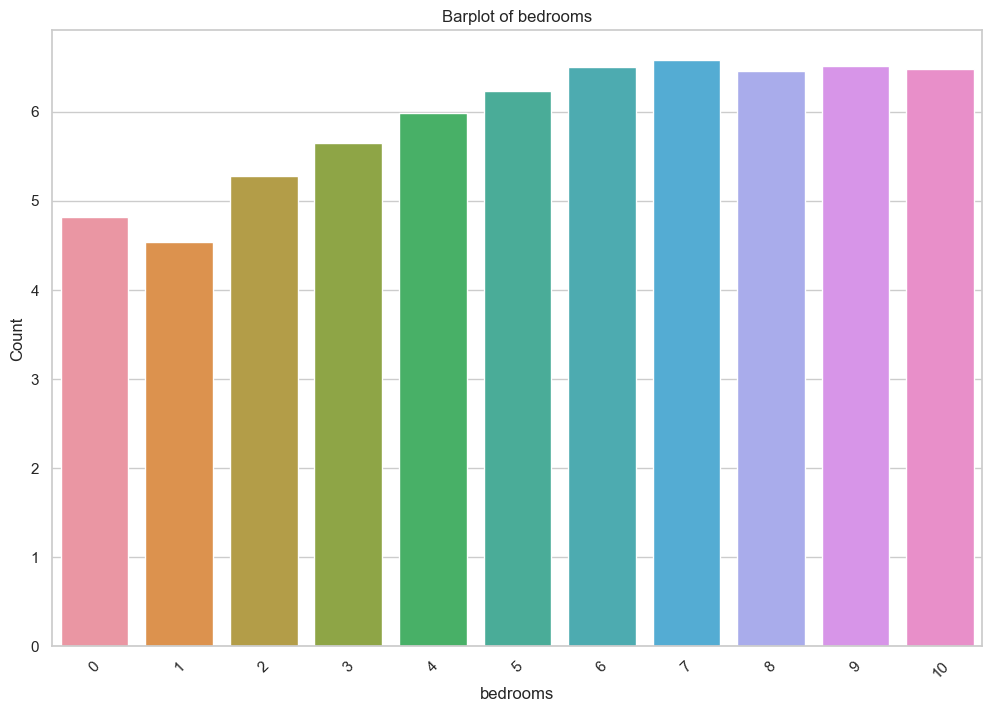

<AxesSubplot: title={'center': 'Barplot of bedrooms'}, xlabel='bedrooms', ylabel='Count'>

In [168]:
plot_barplot(mean_log_price_wrt_bedr, 'bedrooms', 'log_price')

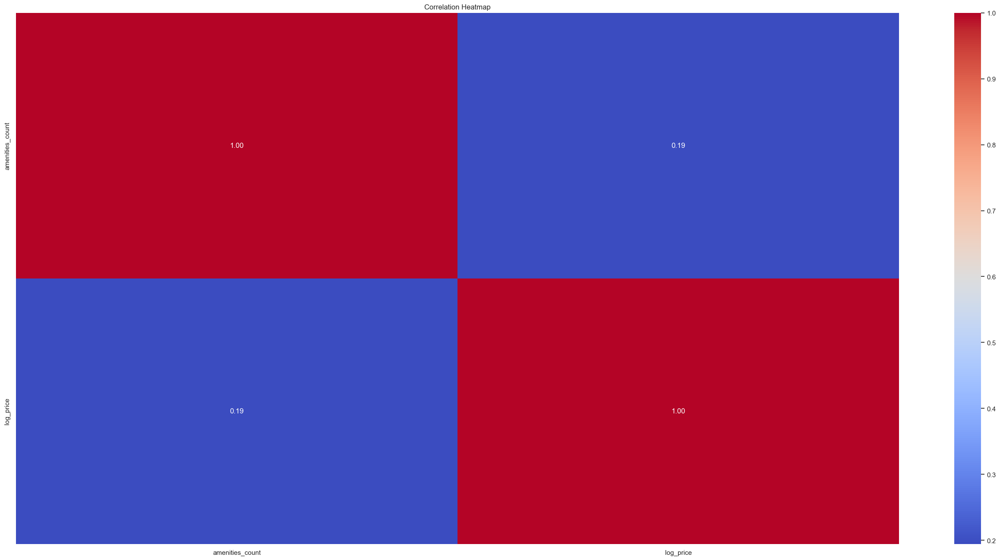

In [169]:
columns_to_include = ['amenities_count','log_price']
# Plot correlation heatmap
plot_correlation_heatmap(df, columns_to_include)

In [170]:
mean_log_price_wrt_ac = df.groupby(df['amenities_count'])['log_price'].mean().to_frame().reset_index() # return the dataframe of bathrooms & mean log-price

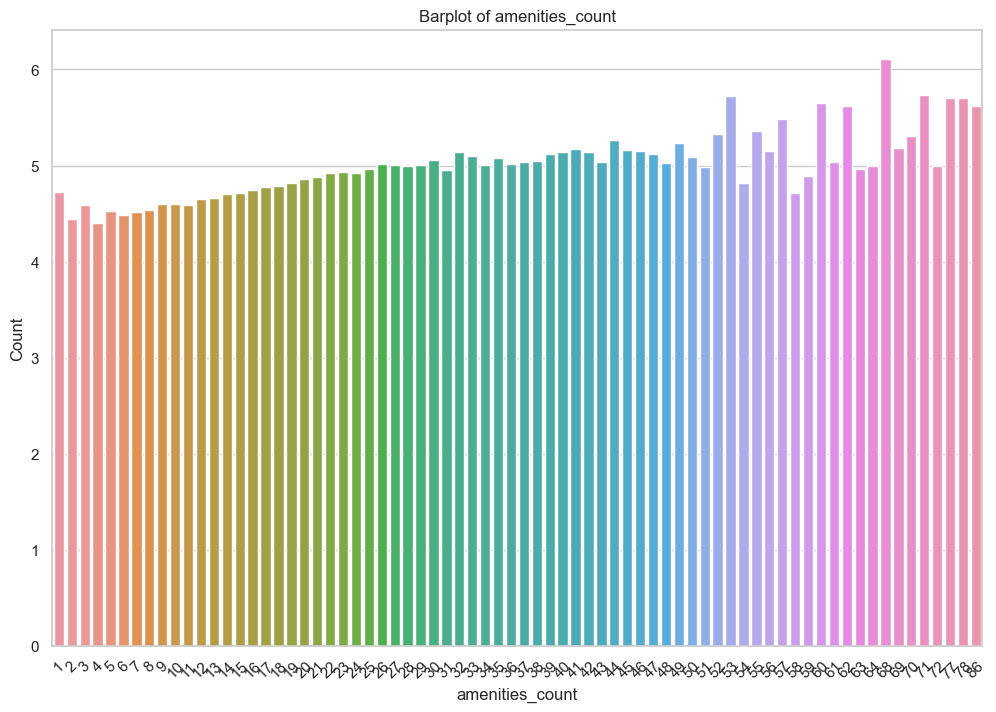

<AxesSubplot: title={'center': 'Barplot of amenities_count'}, xlabel='amenities_count', ylabel='Count'>

In [171]:
plot_barplot(mean_log_price_wrt_ac, 'amenities_count', 'log_price')

In [172]:
# Example usage:
aggregate_columns = ['property_type','room_type', 'accommodates','bathrooms', 'bedrooms','neighbourhood', 'cancellation_policy']
mode_data_city = calculate_mode(df, 'city', aggregate_columns)


In [173]:
mode_data_city

,mode_property_type,mode_room_type,mode_accommodates,mode_bathrooms,mode_bedrooms,mode_neighbourhood,mode_cancellation_policy
city,,,,,,,
Boston,Apartment,Entire home/apt,2,1,1,Allston-Brighton,strict
Chicago,Apartment,Entire home/apt,2,1,1,Lakeview,strict
DC,Apartment,Entire home/apt,2,1,1,Capitol Hill,flexible
LA,Apartment,Entire home/apt,2,1,1,Mid-Wilshire,strict
NYC,Apartment,Entire home/apt,2,1,1,Williamsburg,strict
SF,Apartment,Entire home/apt,2,1,1,Mission District,strict


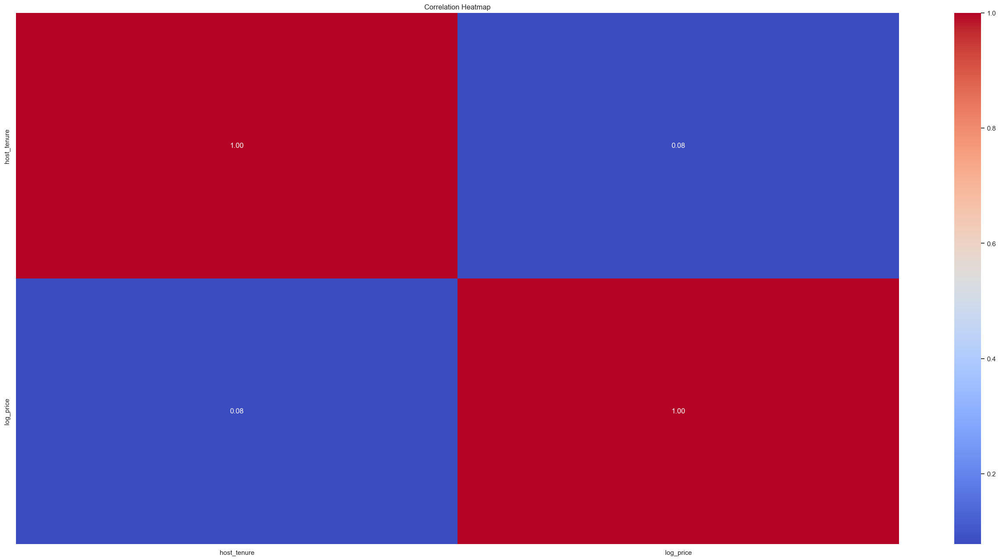

In [174]:
columns_to_include = ['host_tenure','log_price']
# Plot correlation heatmap
plot_correlation_heatmap(df, columns_to_include)

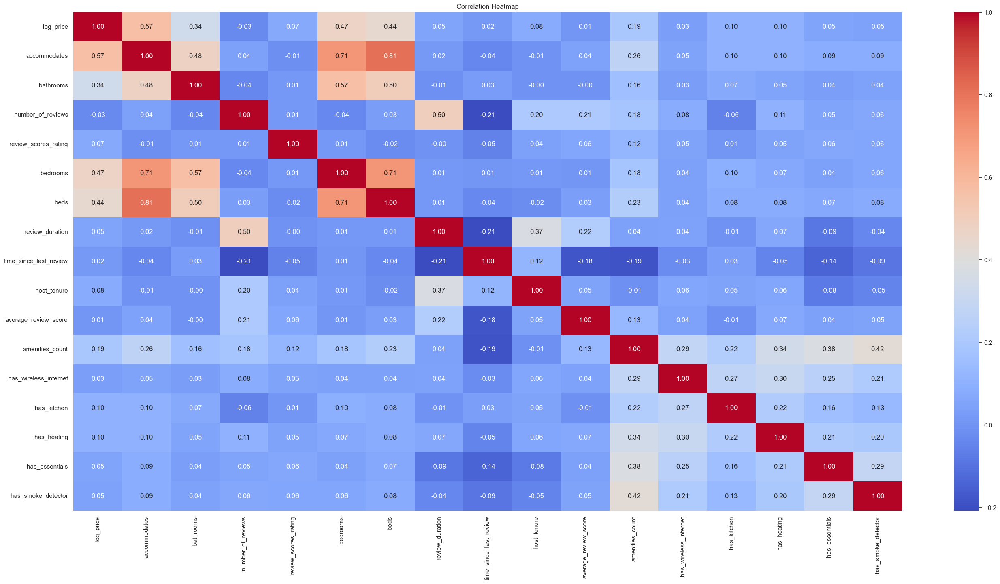

In [175]:
columns_to_include = ['log_price','accommodates', 'bathrooms','number_of_reviews',
       'review_scores_rating', 'bedrooms', 'beds',
       'review_duration', 'time_since_last_review', 'host_tenure',
       'average_review_score', 'amenities_count', 'has_wireless_internet',
       'has_kitchen', 'has_heating', 'has_essentials', 'has_smoke_detector']

corr_df = df[columns_to_include].corr()
# Plot correlation heatmap
plot_correlation_heatmap(df, columns_to_include)

In [176]:
correlatiomn_matrix = corr_df['log_price'].sort_values(ascending=False).to_frame().reset_index()

In [177]:
correlatiomn_matrix

,index,log_price
0,log_price,1.000000
1,accommodates,0.567574
2,bedrooms,0.473028
3,beds,0.441619
4,bathrooms,0.335589
5,amenities_count,0.194528
6,has_heating,0.103929
7,has_kitchen,0.101046
8,host_tenure,0.078244
9,review_scores_rating,0.074475


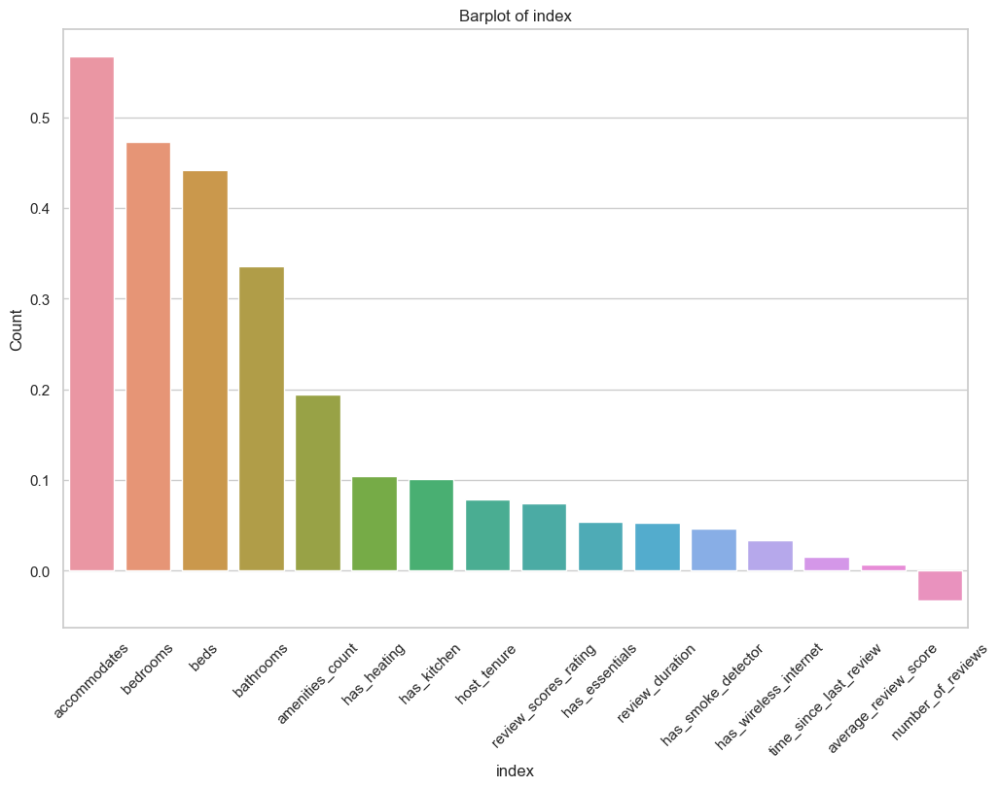

<AxesSubplot: title={'center': 'Barplot of index'}, xlabel='index', ylabel='Count'>

In [178]:
plot_barplot(correlatiomn_matrix.iloc[1:], 'index', 'log_price') # Correlation matrix

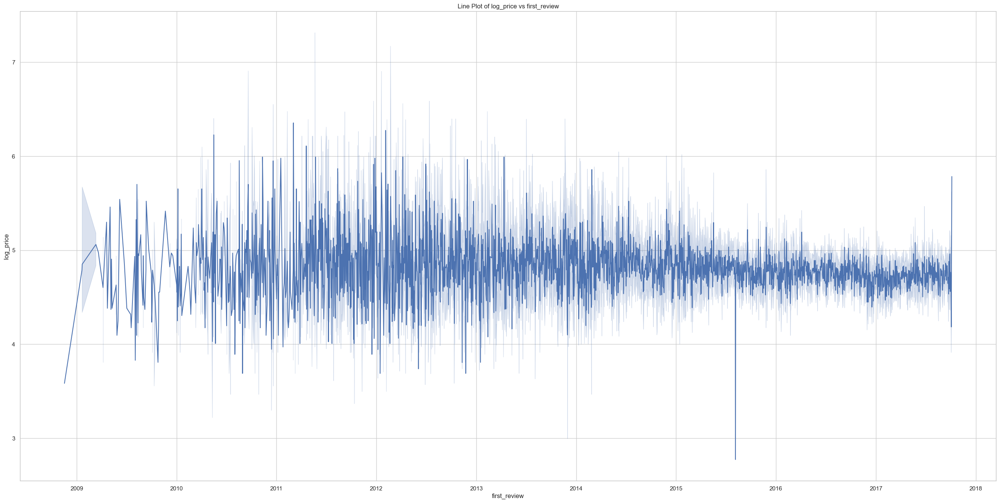

In [179]:
# Example usage:
plot_lineplot(df, 'first_review','log_price' )

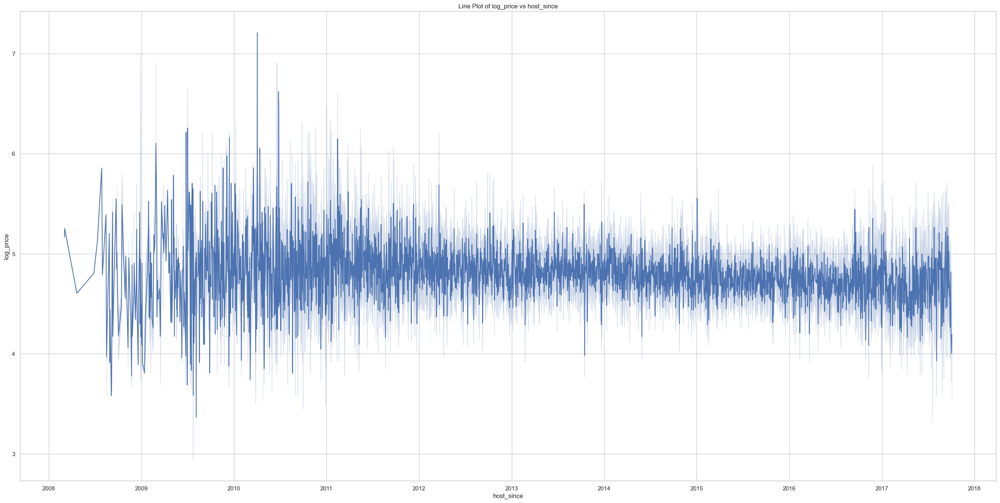

In [180]:
plot_lineplot(df, 'host_since','log_price' )

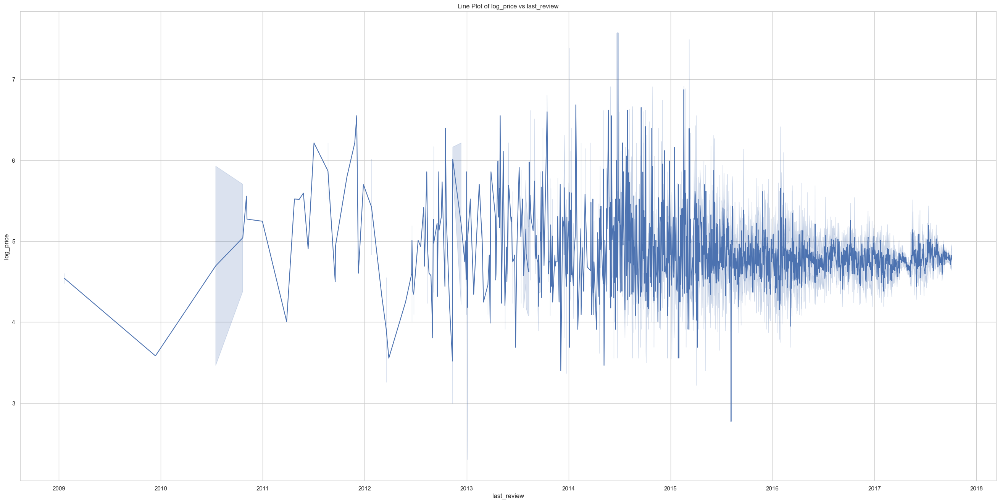

In [181]:
plot_lineplot(df, 'last_review','log_price' )

In [182]:
df[['property_type','room_type']]

,property_type,room_type
0,Apartment,Entire home/apt
1,Apartment,Entire home/apt
2,Apartment,Entire home/apt
3,House,Entire home/apt
4,Apartment,Entire home/apt
...,...,...
74106,Apartment,Private room
74107,Apartment,Entire home/apt
74108,Apartment,Entire home/apt
74109,Apartment,Entire home/apt


In [183]:
pt_rt_df = df.groupby(['property_type','room_type'])['room_type'].count().to_frame()

pt_rt_df.columns = ['room_type_count']
pt_rt_df = pt_rt_df.reset_index()

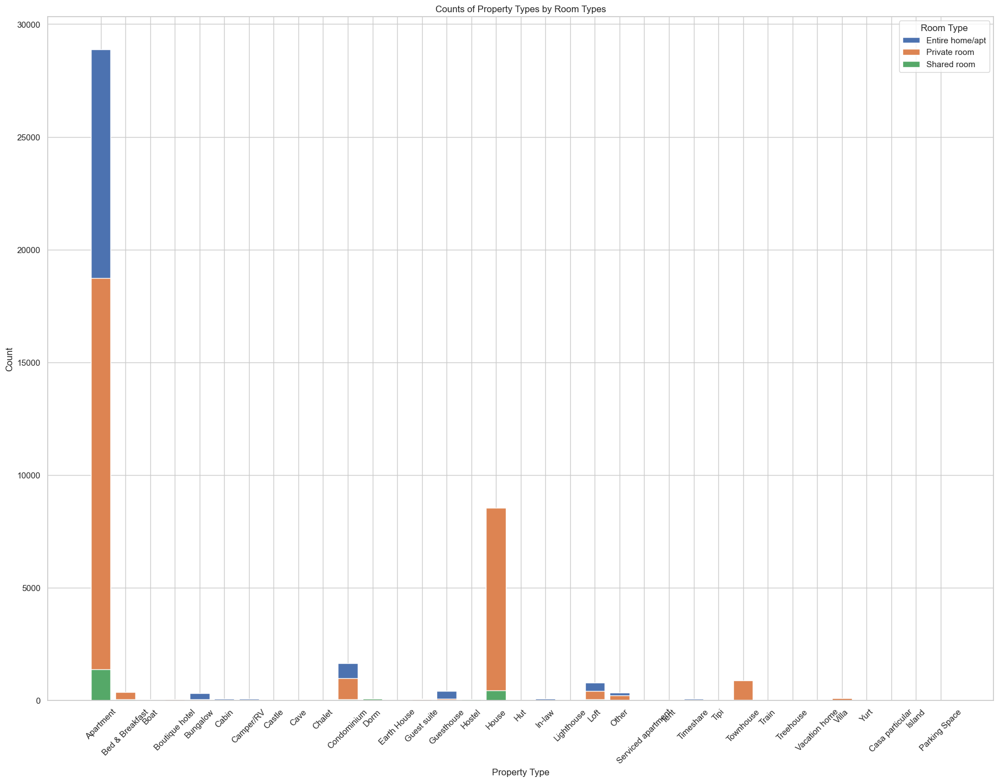

In [184]:
# Set Seaborn style
sns.set_style("whitegrid")

# Plot unstacked bar chart
plt.figure(figsize=(22, 16))
for room_type in pt_rt_df['room_type'].unique():
    subset = pt_rt_df[pt_rt_df['room_type'] == room_type]
    plt.bar(subset['property_type'], subset['room_type_count'], label=room_type)

plt.title('Counts of Property Types by Room Types')
plt.xlabel('Property Type')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Room Type')
plt.show()


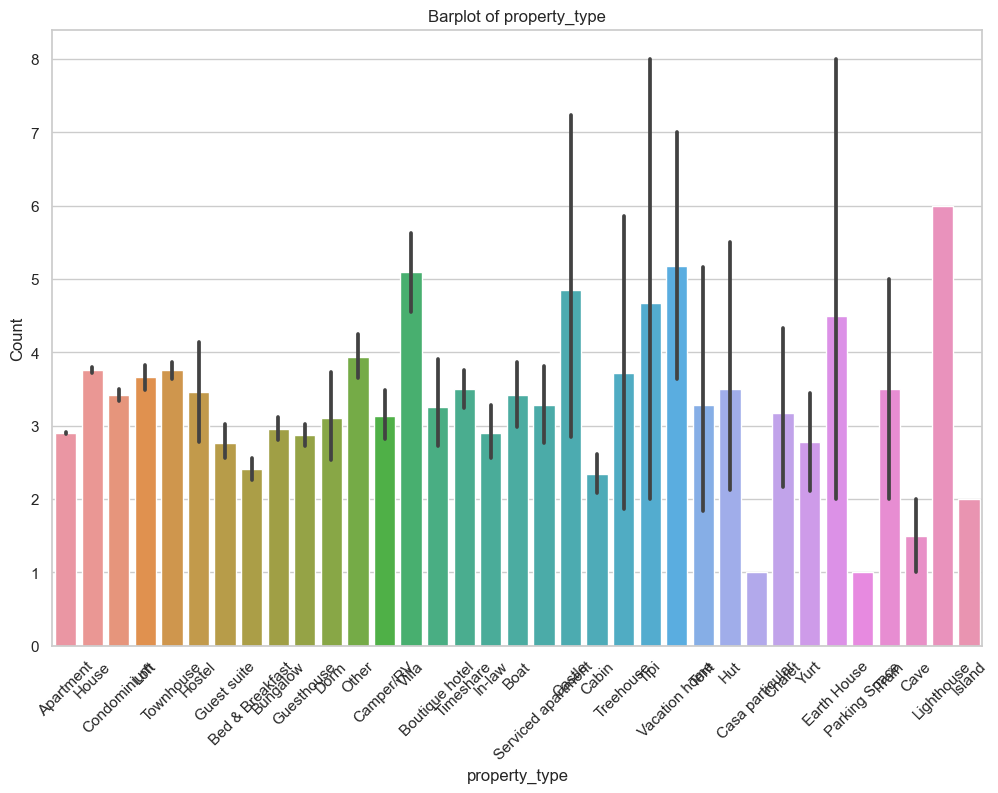

<AxesSubplot: title={'center': 'Barplot of property_type'}, xlabel='property_type', ylabel='Count'>

In [185]:
plot_barplot(df, 'property_type','accommodates')

In [186]:
pt_cp_df = df.groupby(['property_type','cancellation_policy'])['cancellation_policy'].count().to_frame()

pt_cp_df.columns = ['cancellation_policy_count']
pt_cp_df = pt_cp_df.reset_index()

In [187]:
pt_cp_df

,property_type,cancellation_policy,cancellation_policy_count
0,Apartment,flexible,15288
1,Apartment,moderate,12318
2,Apartment,strict,21301
3,Apartment,super_strict_30,96
4,Bed & Breakfast,flexible,187
...,...,...,...
92,Villa,strict,104
93,Villa,super_strict_60,5
94,Yurt,flexible,6
95,Yurt,moderate,2


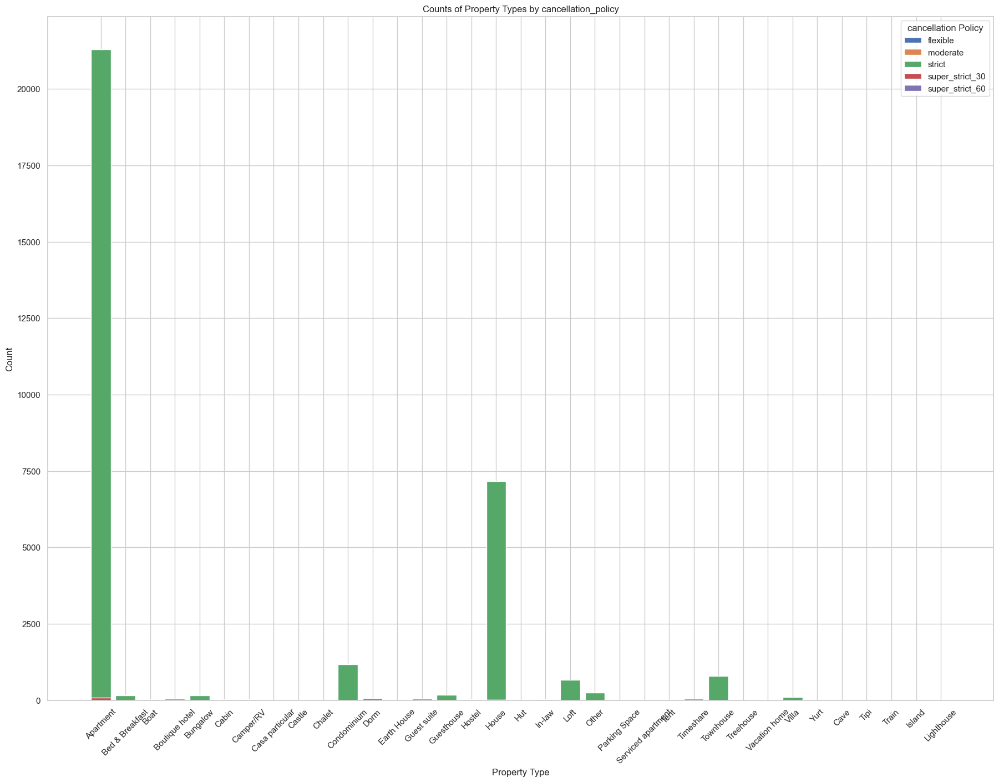

In [188]:
# Set Seaborn style
sns.set_style("whitegrid")

# Plot unstacked bar chart
plt.figure(figsize=(22, 16))
for cancellation_policy in pt_cp_df['cancellation_policy'].unique():
    subset = pt_cp_df[pt_cp_df['cancellation_policy'] == cancellation_policy]
    plt.bar(subset['property_type'], subset['cancellation_policy_count'], label=cancellation_policy)

plt.title('Counts of Property Types by cancellation_policy')
plt.xlabel('Property Type')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='cancellation Policy')
plt.show()


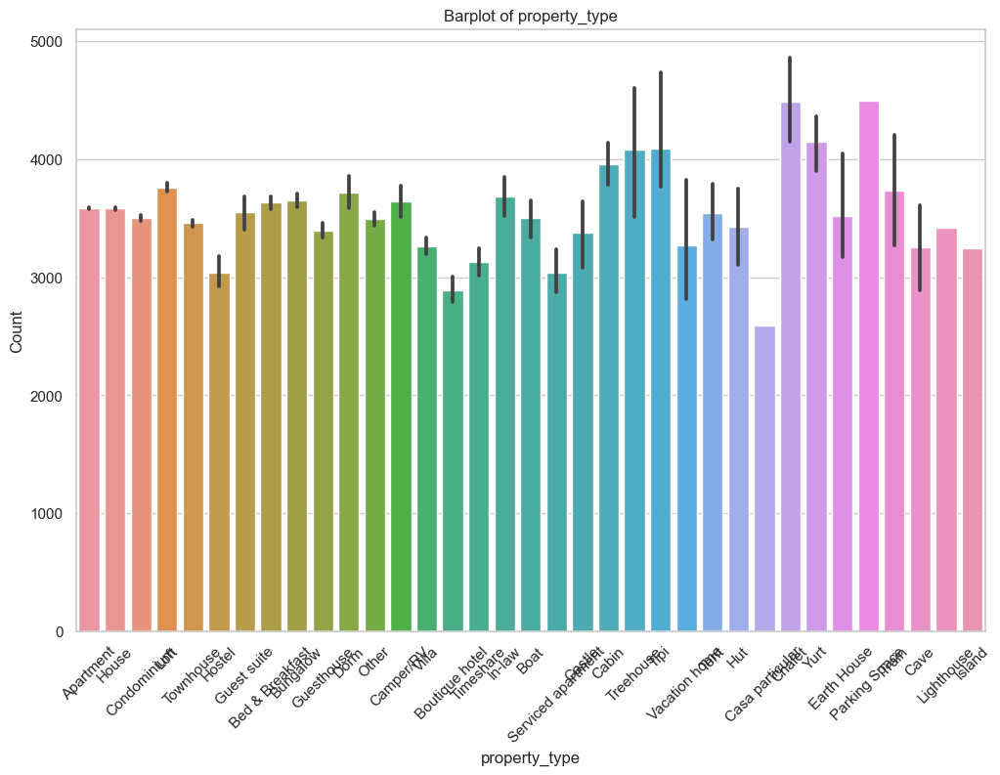

<AxesSubplot: title={'center': 'Barplot of property_type'}, xlabel='property_type', ylabel='Count'>

In [189]:
plot_barplot(df, 'property_type','host_tenure')

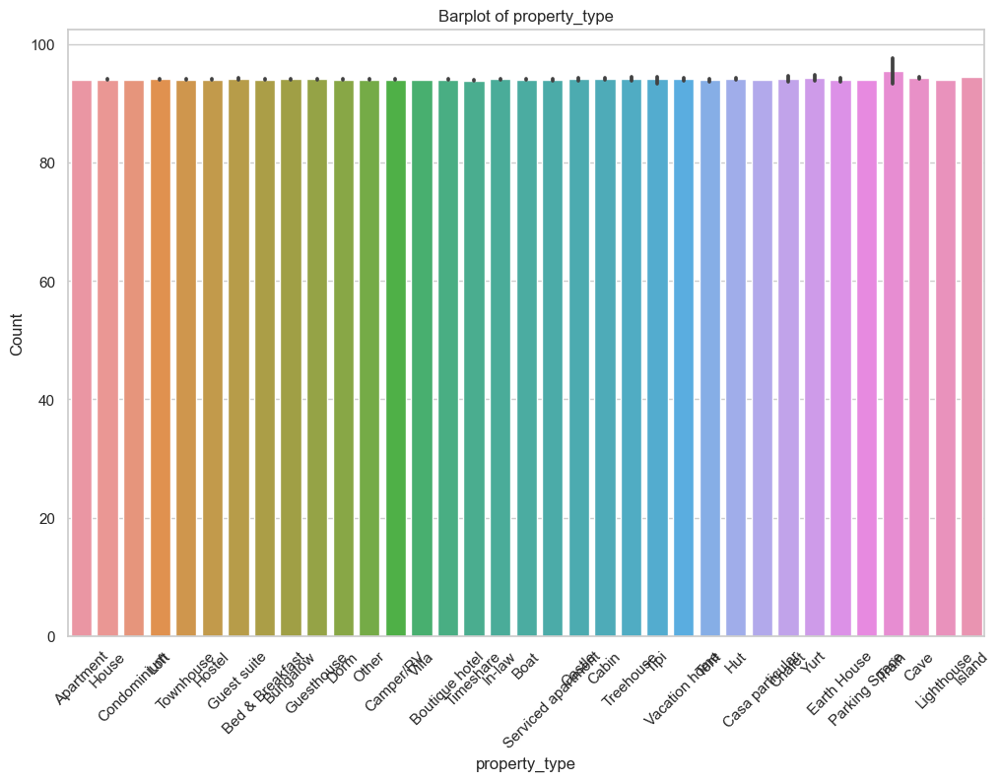

<AxesSubplot: title={'center': 'Barplot of property_type'}, xlabel='property_type', ylabel='Count'>

In [190]:
plot_barplot(df, 'property_type','average_review_score')

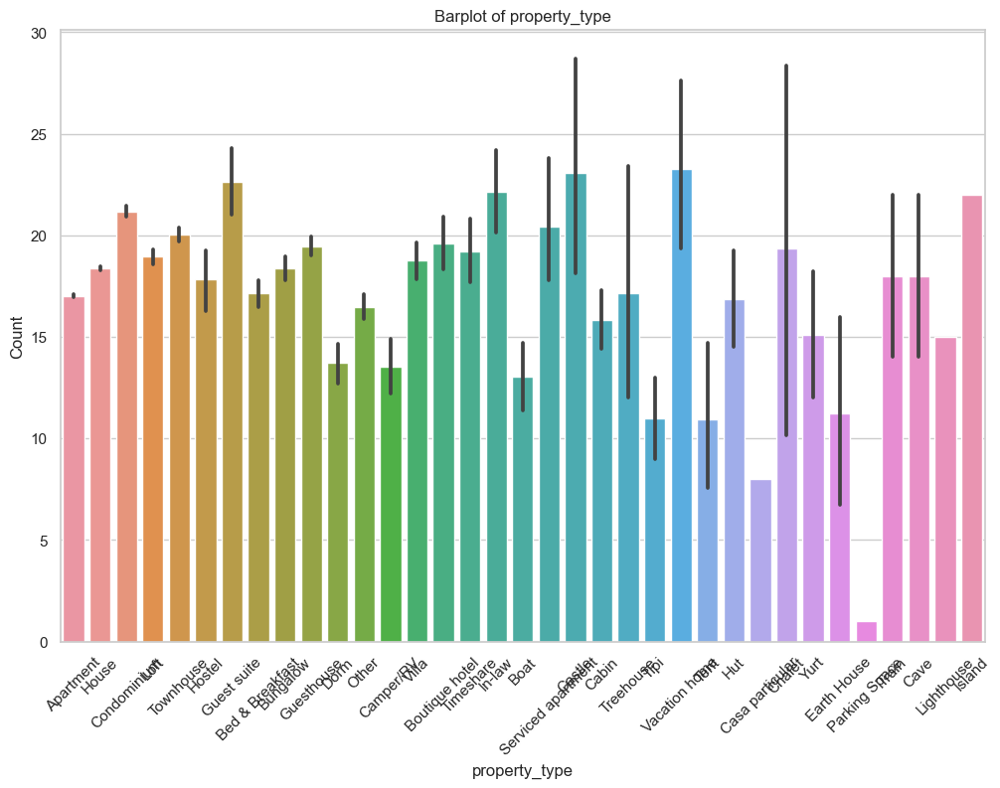

<AxesSubplot: title={'center': 'Barplot of property_type'}, xlabel='property_type', ylabel='Count'>

In [191]:
plot_barplot(df, 'property_type','amenities_count')

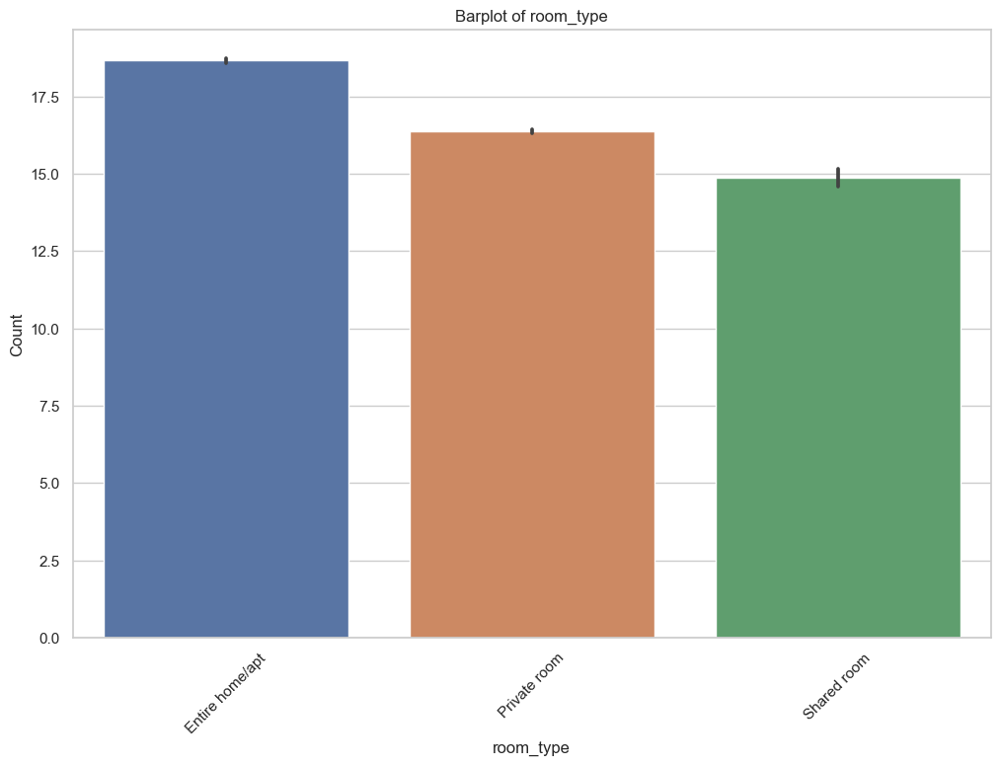

<AxesSubplot: title={'center': 'Barplot of room_type'}, xlabel='room_type', ylabel='Count'>

In [192]:
plot_barplot(df, 'room_type','amenities_count')

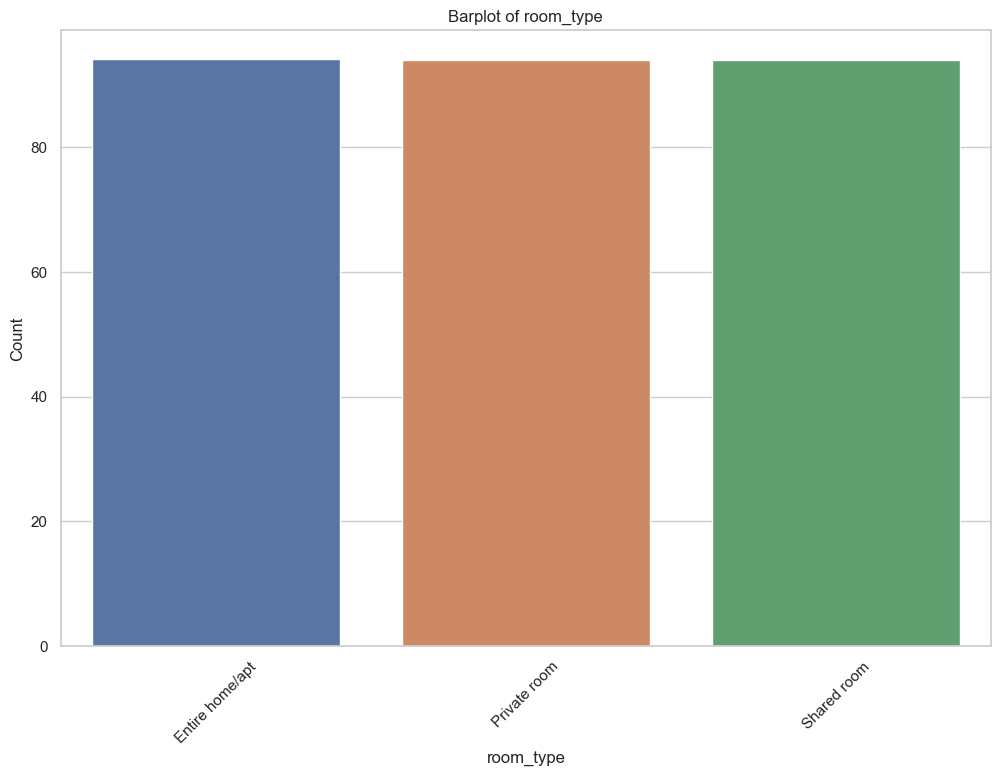

<AxesSubplot: title={'center': 'Barplot of room_type'}, xlabel='room_type', ylabel='Count'>

In [193]:
plot_barplot(df, 'room_type','average_review_score')

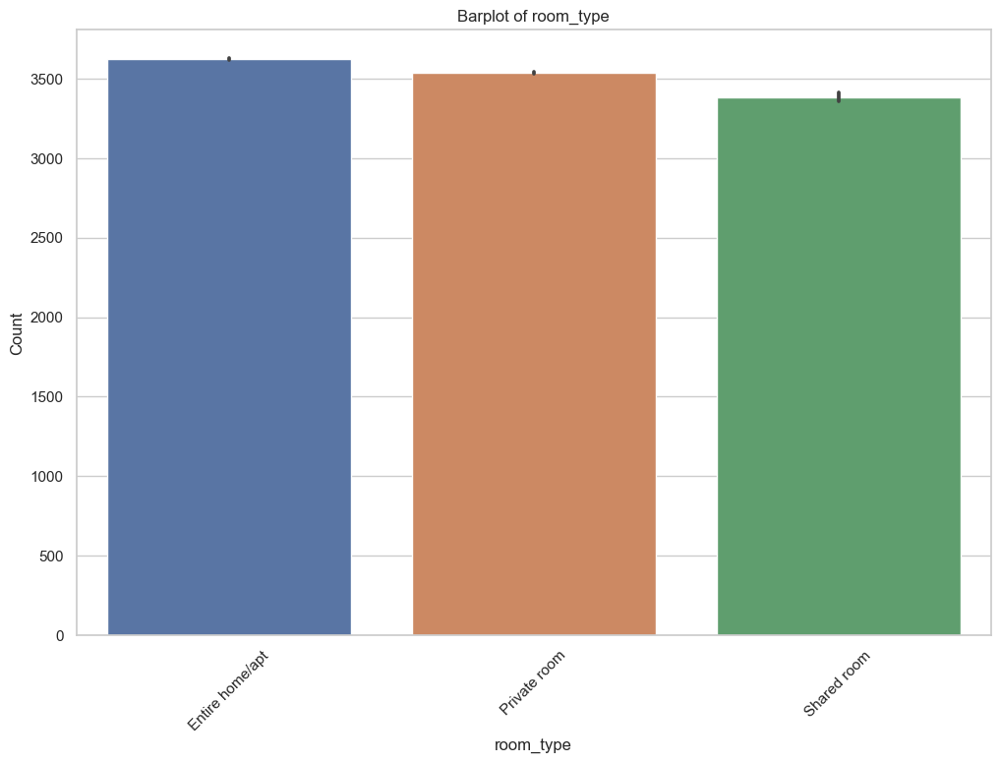

<AxesSubplot: title={'center': 'Barplot of room_type'}, xlabel='room_type', ylabel='Count'>

In [194]:
plot_barplot(df, 'room_type','host_tenure')

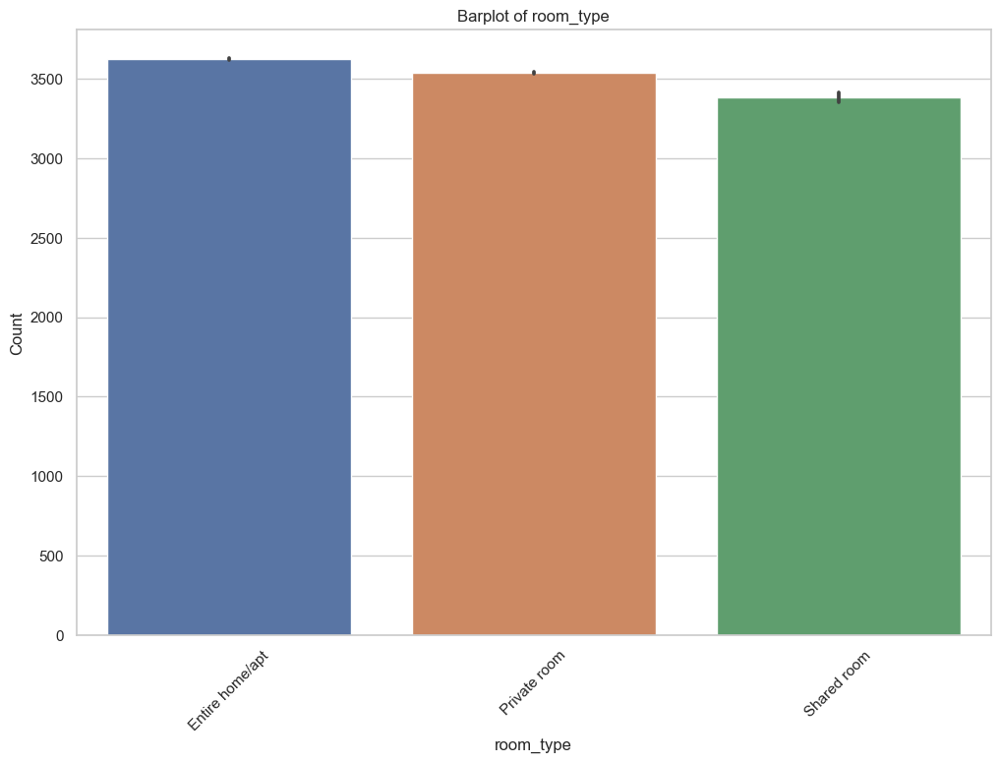

<AxesSubplot: title={'center': 'Barplot of room_type'}, xlabel='room_type', ylabel='Count'>

In [195]:
plot_barplot(df, 'room_type','host_tenure')

---

# Sentiment Analysis

Here iam not performing any text preprocessing , because it is oneshot sentiment analysis
if i done any stopwords remvoal or lemmatization or stemming it may be give less acurrcy
hence iam skipping the part of preprocessing here


- we have covered ratings part here

In [196]:
# Download VADER lexicon (if not already downloaded)
nltk.download('vader_lexicon')

def get_sentiment_category(text):
    """
    Analyzes the sentiment of the given text and returns the sentiment category.

    Parameters:
    - text (str): The text to analyze for sentiment.

    Returns:
    - str: The sentiment category ('Positive', 'Negative', or 'Neutral').
    """

    # Create sentiment analyzer
    analyzer = SentimentIntensityAnalyzer()

    # Get sentiment scores
    sentiment_scores = analyzer.polarity_scores(text)

    # Determine sentiment category based on the compound score
    compound_score = sentiment_scores['compound']
    if compound_score >= 0.05:
        sentiment_category = 'Positive'
    elif compound_score <= -0.05:
        sentiment_category = 'Negative'
    else:
        sentiment_category = 'Neutral'

    return sentiment_category

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\91845\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [201]:
# df['sentiment_category'] = df['description'].apply(get_sentiment_category)

df_senti = pd.read_csv("intermediate.csv")

senti_dummy = pd.get_dummies(df['sentiment_category'],prefix='senti_',dtype=int)


In [200]:
# df.to_csv("intermediate.csv",index=False)

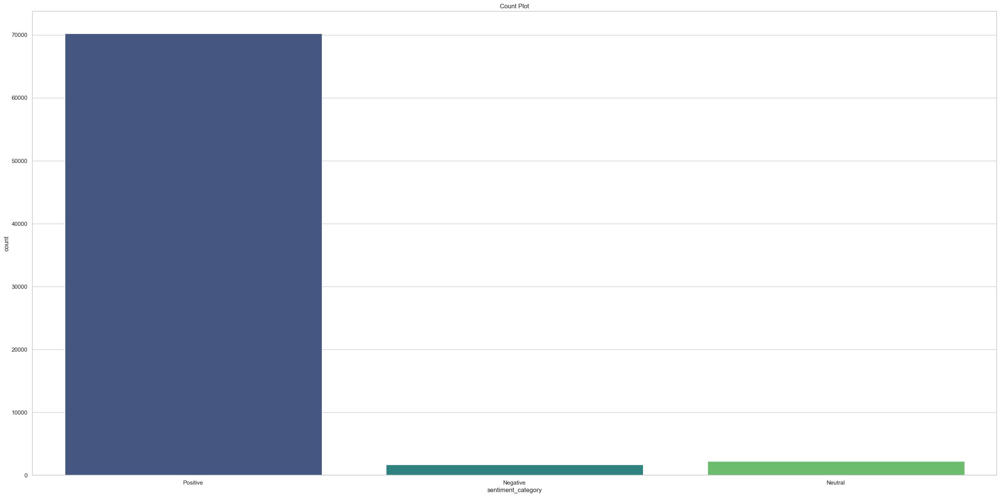

In [202]:
create_seaborn_countplot(df_senti, 'sentiment_category')

In [204]:
pos_property_type = df_senti[df_senti['sentiment_category']=='Positive']['property_type'].value_counts()[:4].to_frame().reset_index()

plot_barplot(pos_property_type, 'property_type', 'count', title='"Most postive comments among properties"')

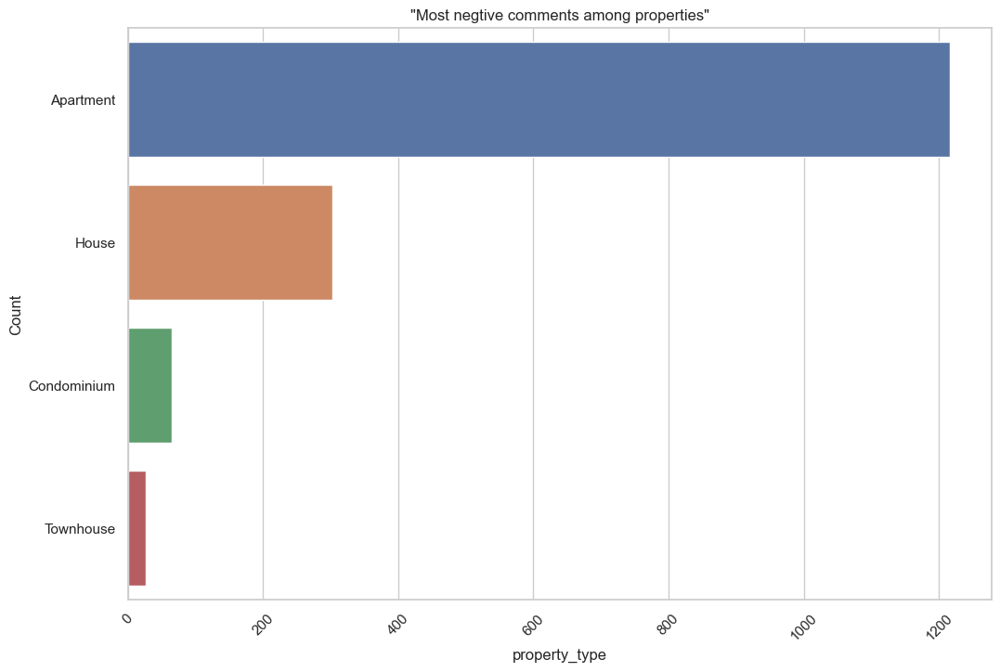

<AxesSubplot: title={'center': '"Most negtive comments among properties"'}, xlabel='property_type', ylabel='Count'>

In [207]:
neg_property_type = df_senti[df_senti['sentiment_category']=='Negative']['property_type'].value_counts()[:4].to_frame().reset_index()

plot_barplot(neg_property_type, 'property_type', 'index', title='"Most negtive comments among properties"')

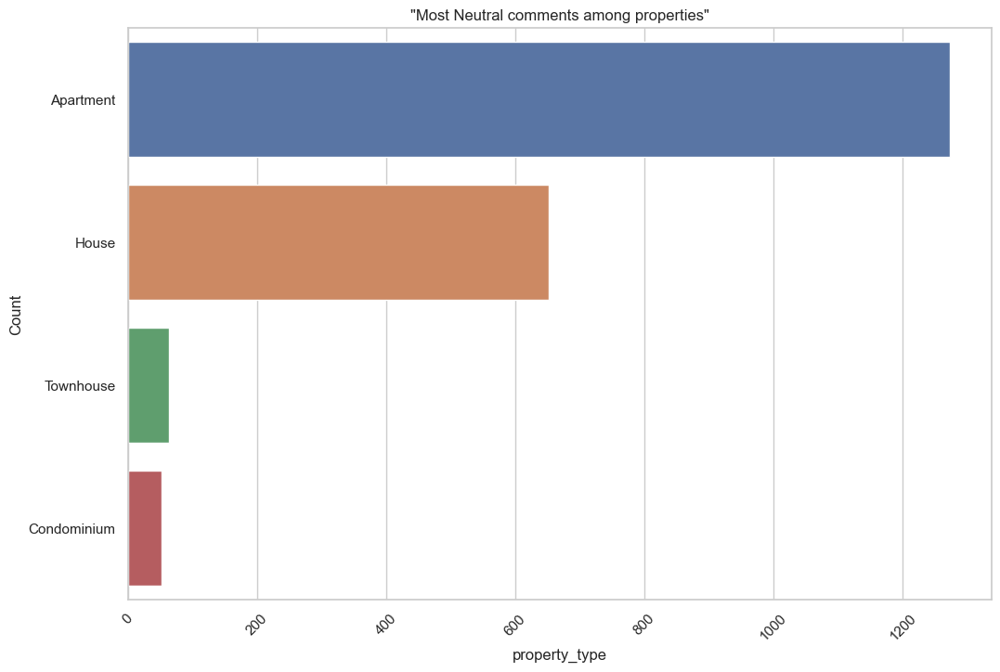

<AxesSubplot: title={'center': '"Most Neutral comments among properties"'}, xlabel='property_type', ylabel='Count'>

In [208]:
neu_property_type = df_senti[df_senti['sentiment_category']=='Neutral']['property_type'].value_counts()[:4].to_frame().reset_index()
plot_barplot(neu_property_type, 'property_type', 'index', title='"Most Neutral comments among properties"')

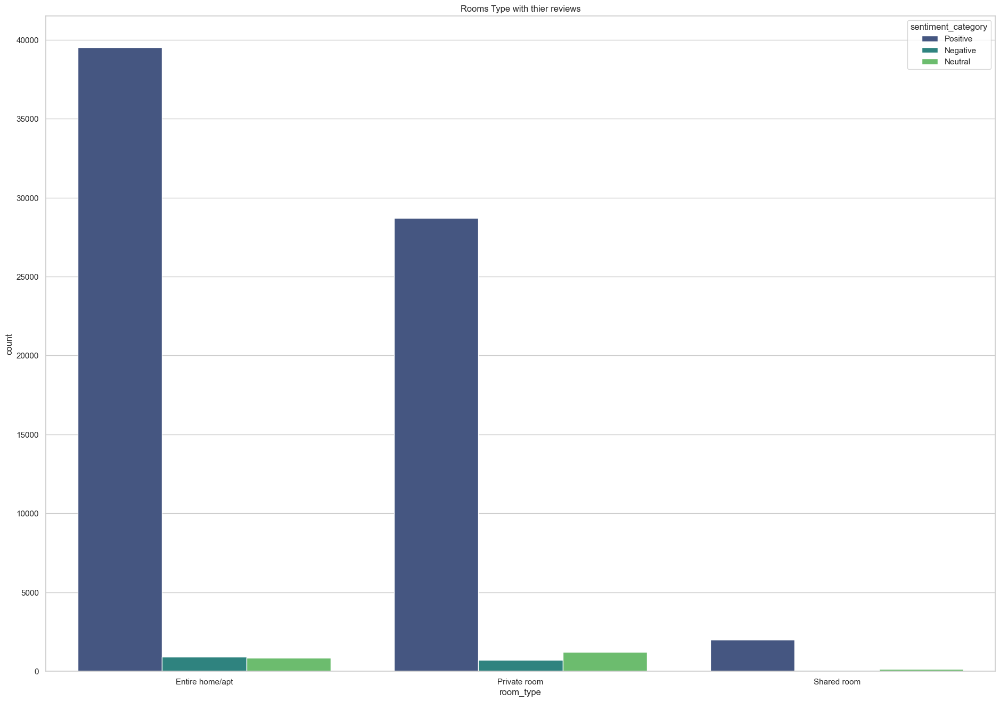

In [209]:

plt.figure(figsize=(23, 16))
sns.countplot(x='room_type', data=df_senti, palette='viridis', hue='sentiment_category')
plt.title('Rooms Type with thier reviews')
plt.show()


In [ ]:
df_senti.columns

---

# Geospatial Analysis

In [210]:
df.columns

Index(['id', 'log_price', 'property_type', 'room_type', 'amenities',
       'accommodates', 'bathrooms', 'bed_type', 'cancellation_policy',
       'cleaning_fee', 'city', 'description', 'first_review',
       'host_has_profile_pic', 'host_identity_verified', 'host_response_rate',
       'host_since', 'instant_bookable', 'last_review', 'latitude',
       'longitude', 'name', 'neighbourhood', 'number_of_reviews',
       'review_scores_rating', 'thumbnail_url', 'zipcode', 'bedrooms', 'beds',
       'amenities_count', 'has_wireless_internet', 'has_kitchen',
       'has_heating', 'has_essentials', 'has_smoke_detector',
       'review_duration', 'time_since_last_review', 'host_tenure',
       'average_review_score', 'sentiment_category'],
      dtype='object')

## 1. Price Distribution Map

In [211]:
import plotly.express as px

fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="log_price", size="log_price",
                        color_continuous_scale=px.colors.sequential.Viridis, size_max=25, zoom=10)
fig.update_layout(mapbox_style="carto-positron", title="Price Distribution Map")
fig.show()


## **Outcome:**
This map will show the spatial distribution of listing prices. Areas with larger marker sizes indicate higher priced listings.

## 2. Neighborhood Price Comparison


In [212]:
neighborhood_prices = df.groupby('neighbourhood')['log_price'].mean().reset_index()

fig = px.bar(neighborhood_prices, x='neighbourhood', y='log_price', title='Average Price by Neighborhood')
fig.show()


## **Outcome:**
This bar plot shows the average listing prices for each neighborhood, allowing you to identify neighborhoods with higher or lower prices.

## 3. Spatial Clustering


In [213]:
from sklearn.cluster import KMeans


kmeans = KMeans(n_clusters=5)  # Adjust number of clusters as needed
df['cluster'] = kmeans.fit_predict(df[['latitude', 'longitude']])

fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="cluster",
                        color_continuous_scale=px.colors.sequential.Viridis, zoom=10)
fig.update_layout(mapbox_style="carto-positron", title="Spatial Clustering of Listings")
fig.show()


## **Outcome:**
This map shows spatial clusters of listings with similar pricing patterns, helping identify areas with distinct pricing characteristics.

## 4. Heatmaps


In [214]:
import plotly.express as px

# Define city coordinates
city_coordinates = {
    'NYC': {'latitude': 40.7128, 'longitude': -74.0060},
    'SF': {'latitude': 37.7749, 'longitude': -122.4194},
    'DC': {'latitude': 38.9072, 'longitude': -77.0369},
    'LA': {'latitude': 34.0522, 'longitude': -118.2437},
    'Chicago': {'latitude': 41.8781, 'longitude': -87.6298},
    'Boston': {'latitude': 42.3601, 'longitude': -71.0589}
}

# Plot density map for each city
for city, coordinates in city_coordinates.items():
    fig = px.density_mapbox(df, lat='latitude', lon='longitude', z='log_price', radius=10,
                            center=dict(lat=coordinates['latitude'], lon=coordinates['longitude']), zoom=10,
                            mapbox_style="carto-positron", title=f"Density Map of Listing Prices in {city}")
    fig.show()


## **Outcome:**
This heatmap visualizes the density of listing prices, with areas of higher density indicating regions with higher or lower prices.

## 5. Interactive Maps


In [215]:
import plotly.express as px

# Create an interactive map
fig = px.scatter_mapbox(df, lat='latitude', lon='longitude', color='log_price', hover_name='neighbourhood',
                        hover_data=['log_price', 'property_type', 'room_type'],
                        color_continuous_scale=px.colors.sequential.Viridis, zoom=10)

# Update map layout
fig.update_layout(mapbox_style="carto-positron", title='Interactive Map of Listing Prices', margin={"r":0,"t":0,"l":0,"b":0})

# Show the interactive map
fig.show()


## 6. Proximity to City Centers

In [216]:
from geopy.distance import great_circle

# Define city center coordinates
city_coordinates = {
    'NYC': {'latitude': 40.7128, 'longitude': -74.0060},
    'SF': {'latitude': 37.7749, 'longitude': -122.4194},
    'DC': {'latitude': 38.9072, 'longitude': -77.0369},
    'LA': {'latitude': 34.0522, 'longitude': -118.2437},
    'Chicago': {'latitude': 41.8781, 'longitude': -87.6298},
    'Boston': {'latitude': 42.3601, 'longitude': -71.0589}
}

# Function to calculate distance to city center
def calculate_distance(row):
    city = row['city']
    listing_coordinates = (row['latitude'], row['longitude'])
    city_center = (city_coordinates[city]['latitude'], city_coordinates[city]['longitude'])
    return great_circle(city_center, listing_coordinates).miles

# Apply the function to create the distance_to_city_center column
df['distance_to_city_center'] = df.apply(calculate_distance, axis=1)

# Plot scatter map
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="distance_to_city_center",
                        color_continuous_scale=px.colors.sequential.Viridis, zoom=10,
                        mapbox_style="carto-positron", title="Proximity to City Centers")
fig.show()


## **Outcome:**
This map shows listings color-coded by their distance from the city center, helping you identify areas closer or farther from the city center.

---

In [1]:
!jupyter nbconvert --to html HomeStay_EDA.ipynb

[NbConvertApp] Converting notebook HomeStay_EDA.ipynb to html
[NbConvertApp] Writing 38810710 bytes to HomeStay_EDA.html


: 